In [230]:
import sys, os
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn


local_path = '\\Users\\frank\\Online dictionnary learning spard coding\\Online-Dictionary-Learning-for-Sparse-Coding'
sys.path.append(local_path)

%load_ext autoreload
%autoreload 2
from Visualization.Audio import AudioVisualization, AudioVisualizer
from Evalution.Reconstruction import Evaluation
from Dataset.Audioselection import AudioPreprocessor
from Model.Audio_model import DictionaryLearner, DictionaryVisualizer
from Dataset.Noise import NoiseAdder

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


### Select some video and preprocess them to learn the dictionnary

In [223]:
directory_path = 'C:\\Users\\frank\\Online dictionnary learning spard coding\\data\\cv-corpus-15.0-delta-2023-09-08\\en\\clips'
num_samples = 100 # Number of audio files to select

preprocessor = AudioPreprocessor(directory_path, num_samples, target_duration=3)
preprocessed_audios = preprocessor.preprocess_all()


In [240]:
learner = DictionaryLearner(n_components=50, alpha=2, max_iter=1000, batch_size= 15)
dictionary = learner.fit(preprocessed_audios)



Training Time: 60.98351979255676 seconds


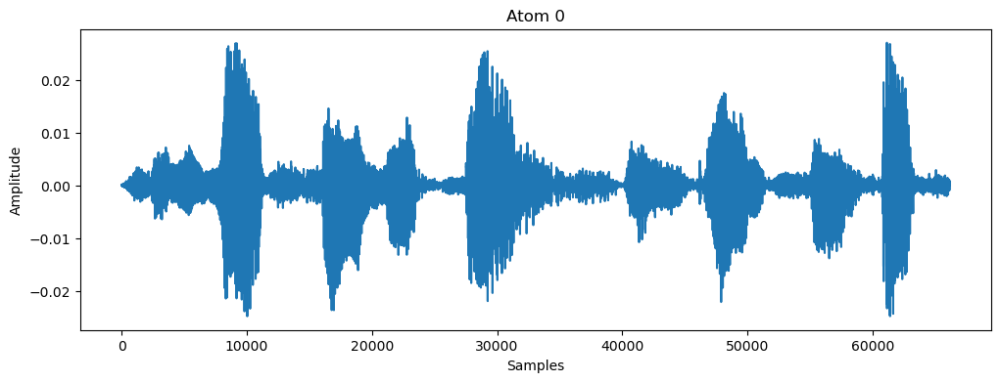

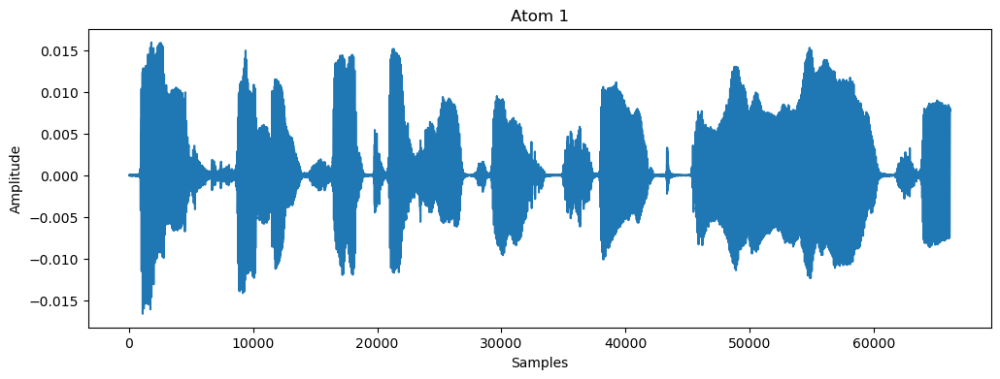

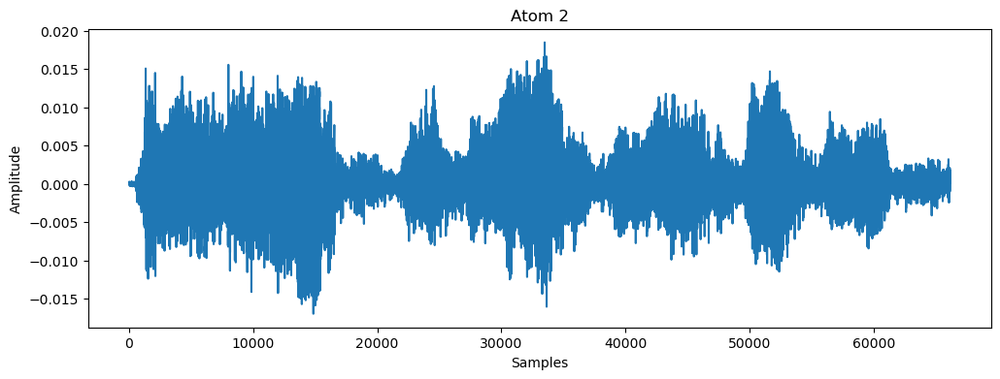

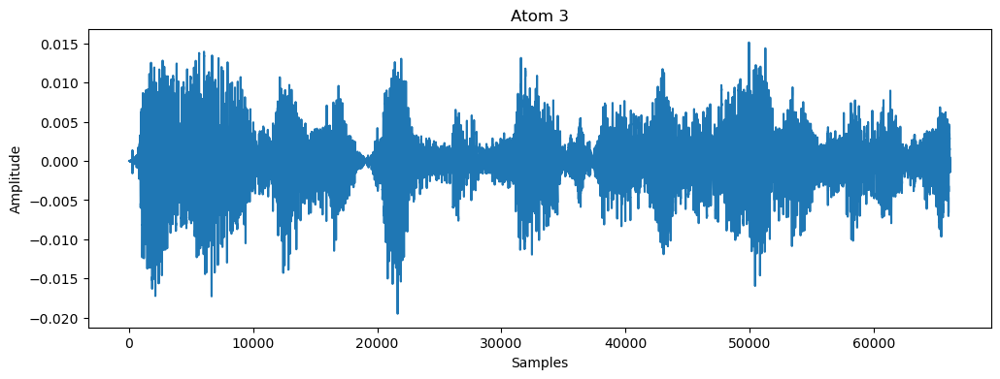

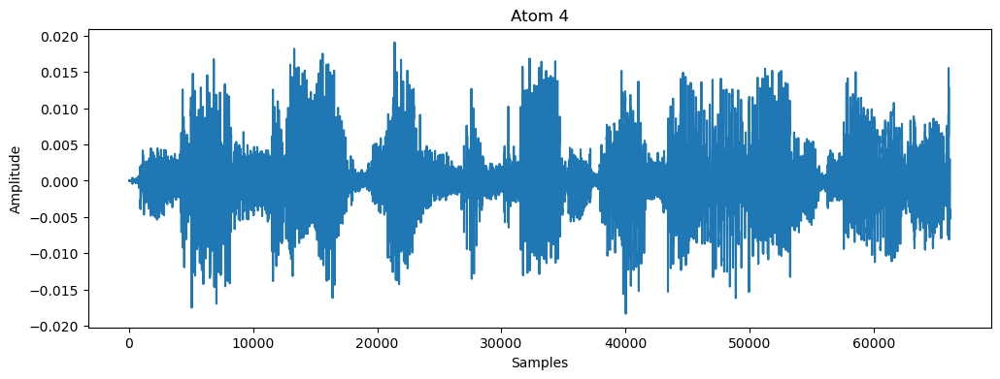

...

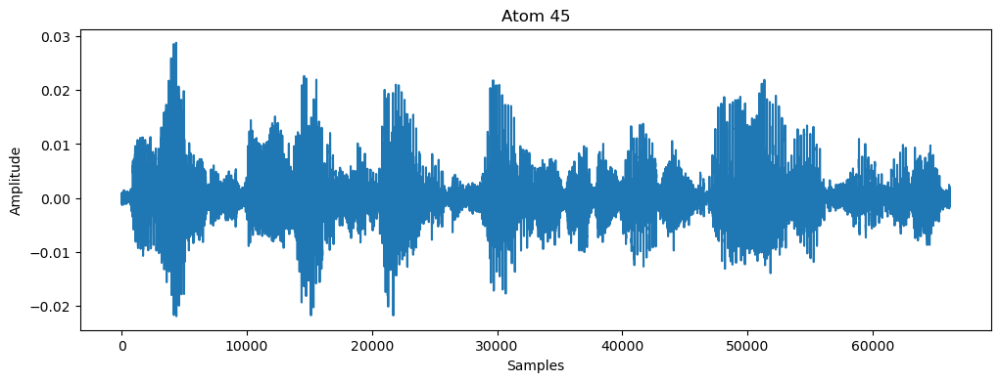

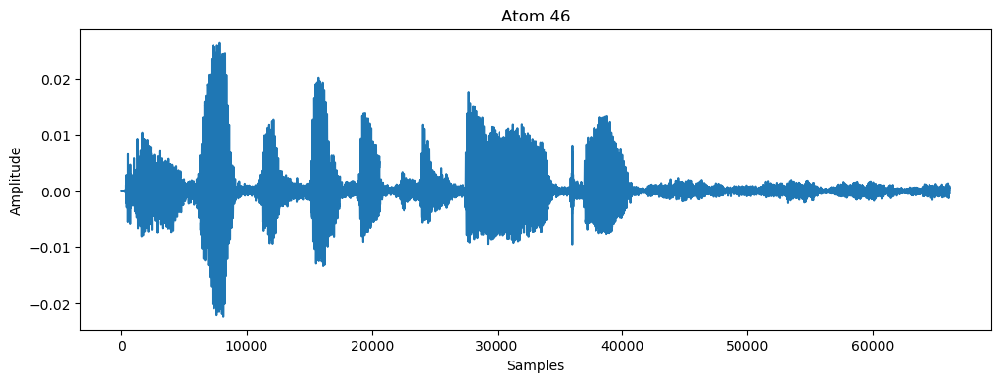

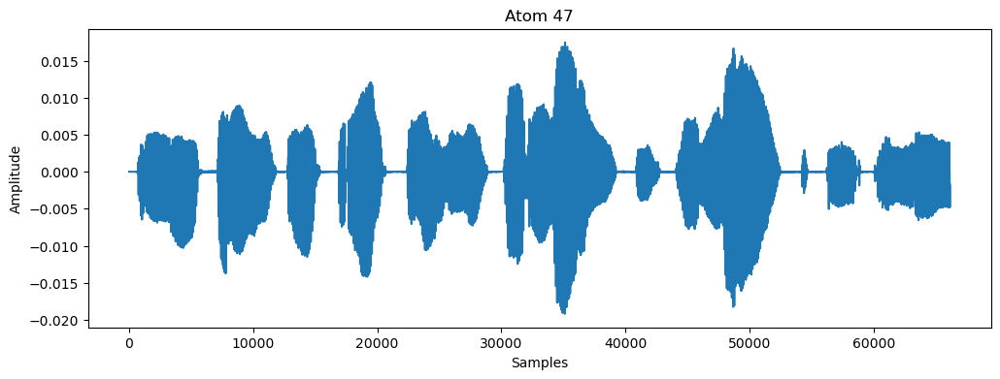

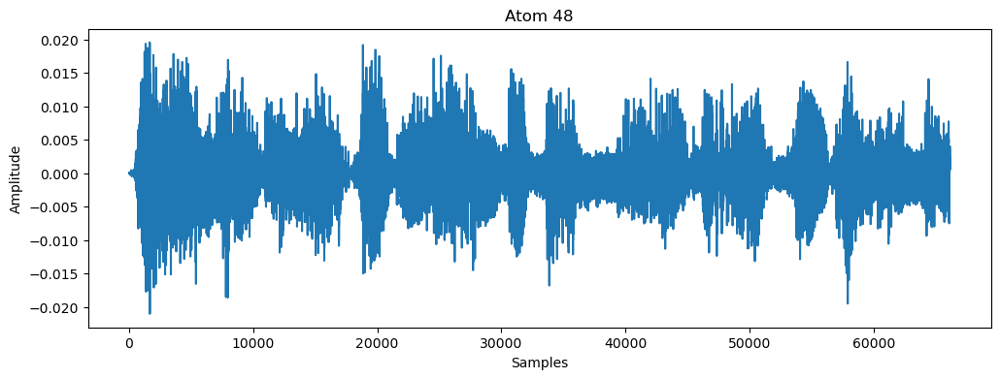

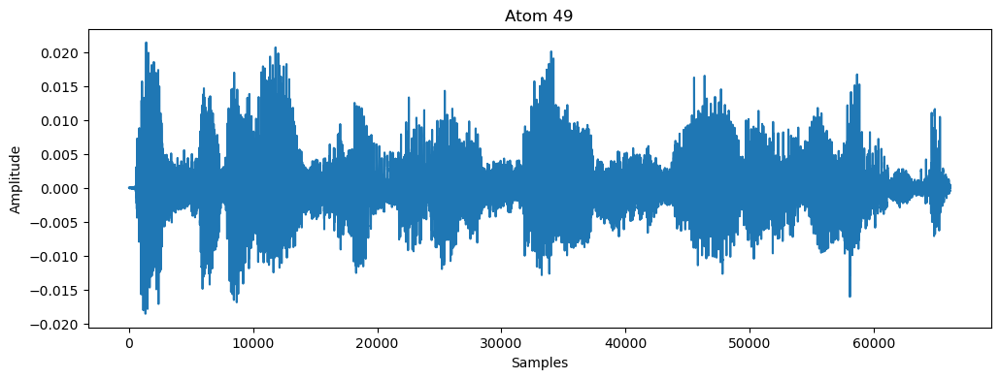

In [225]:

visualizer = DictionaryVisualizer(dictionary, sample_rate=22050)
visualizer.show_all_atoms()

signal 0


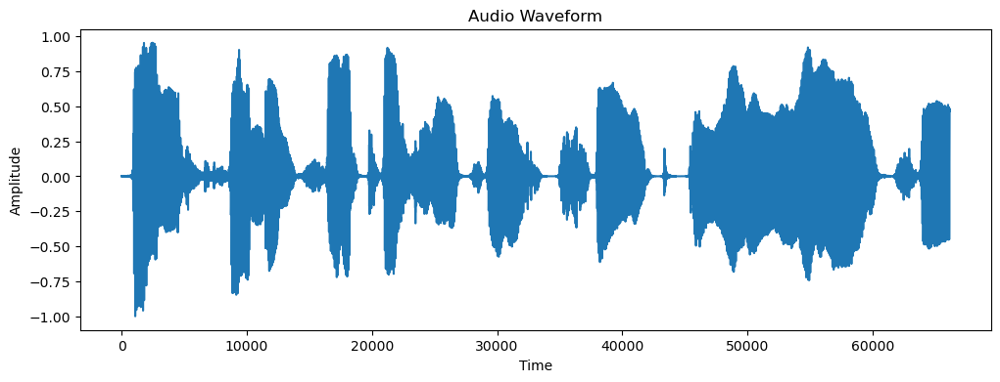

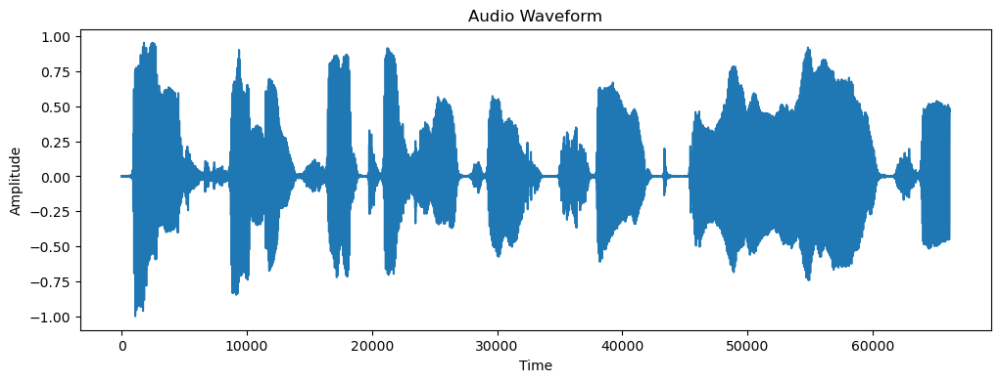

signal 1


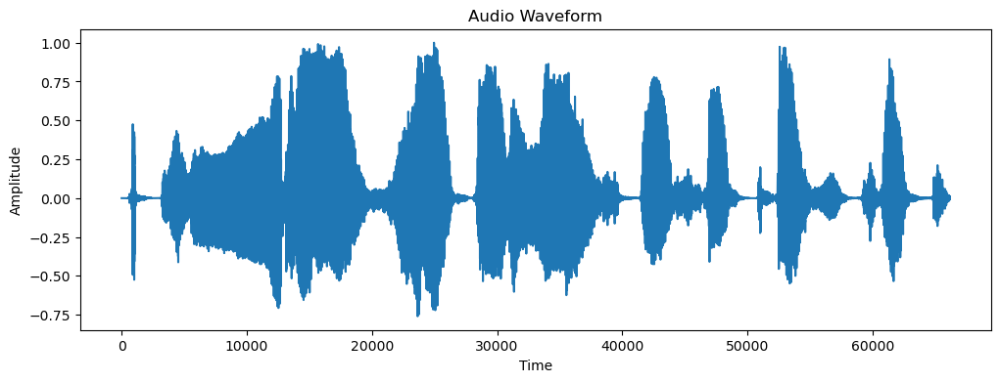

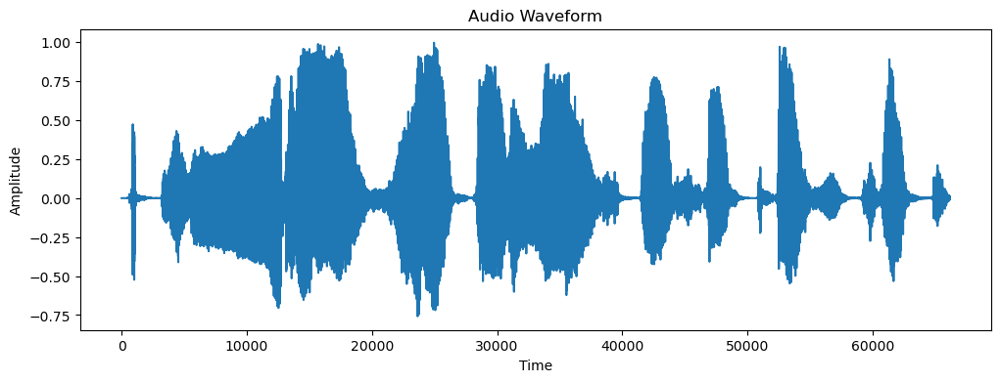

signal 2


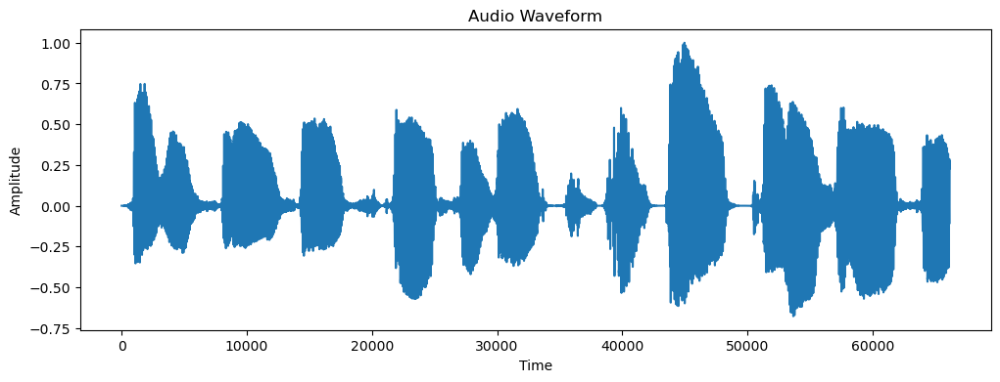

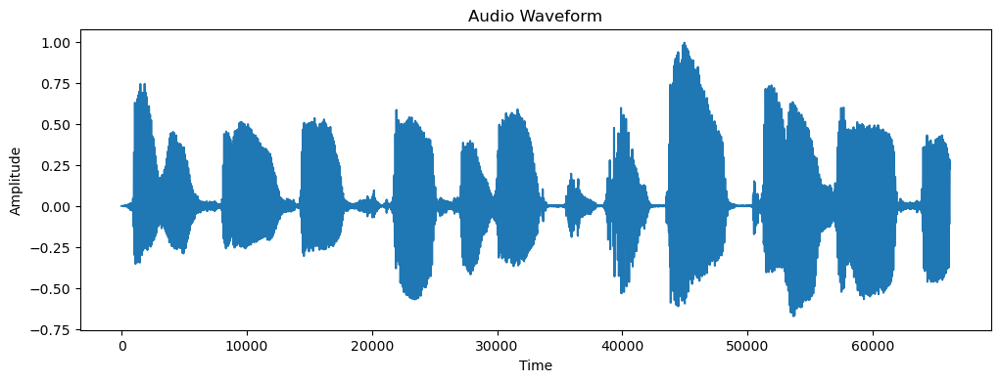

signal 3


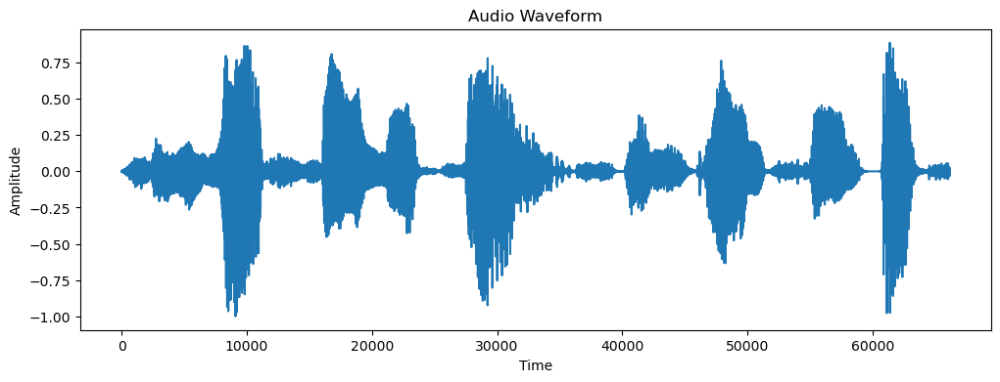

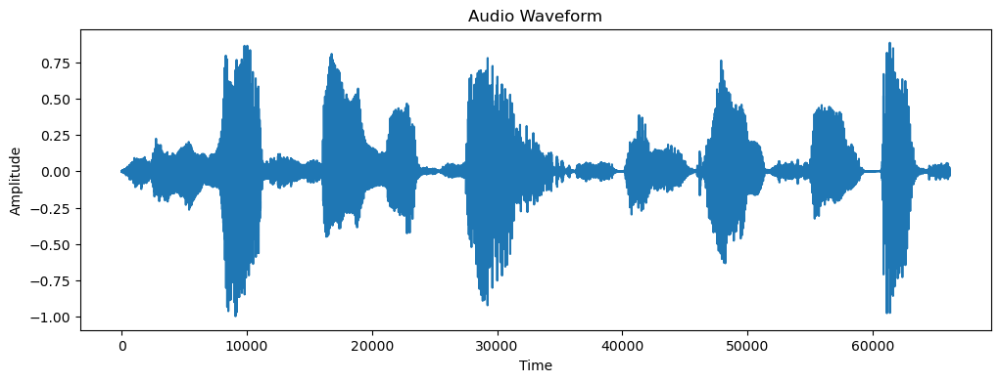

signal 10


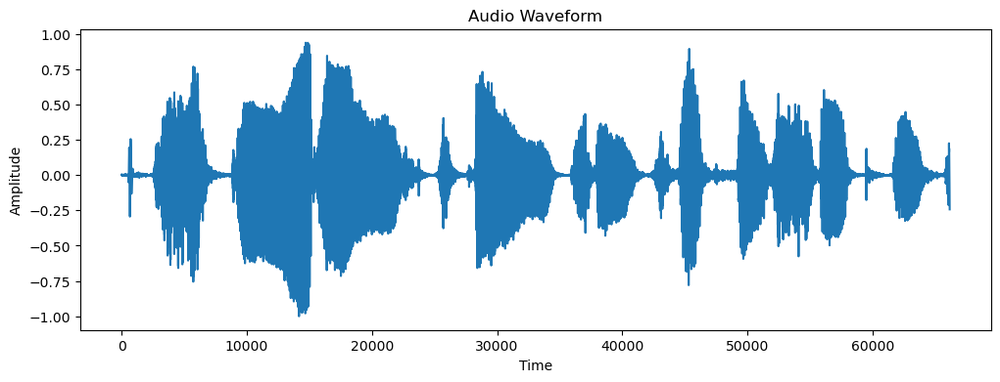

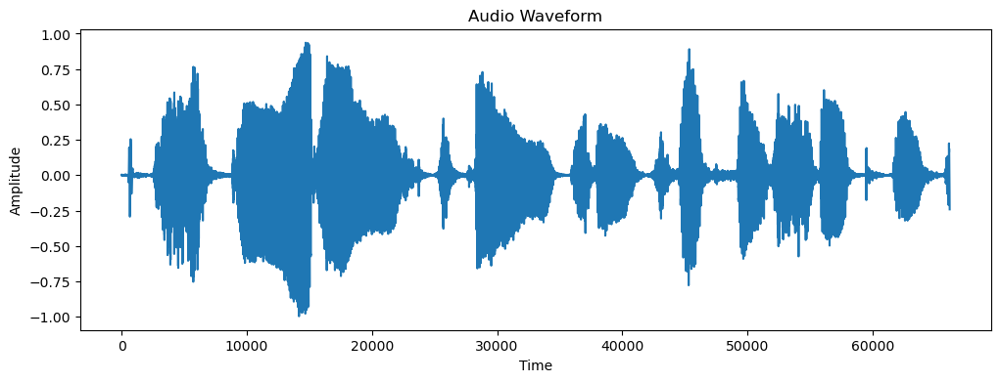

signal 12


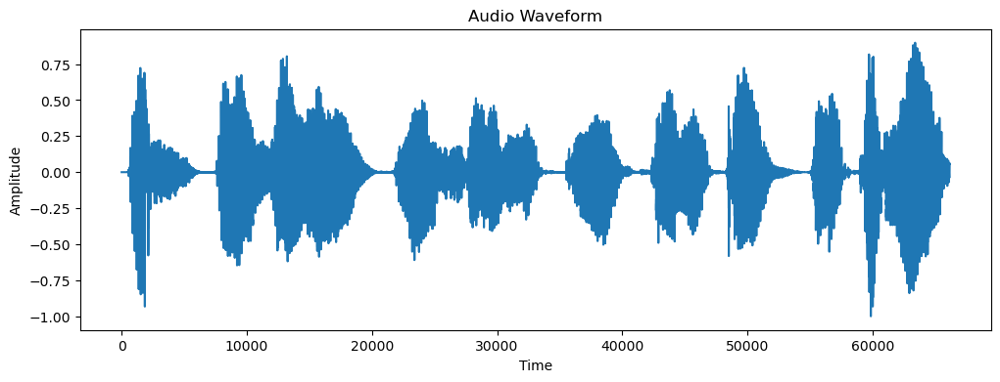

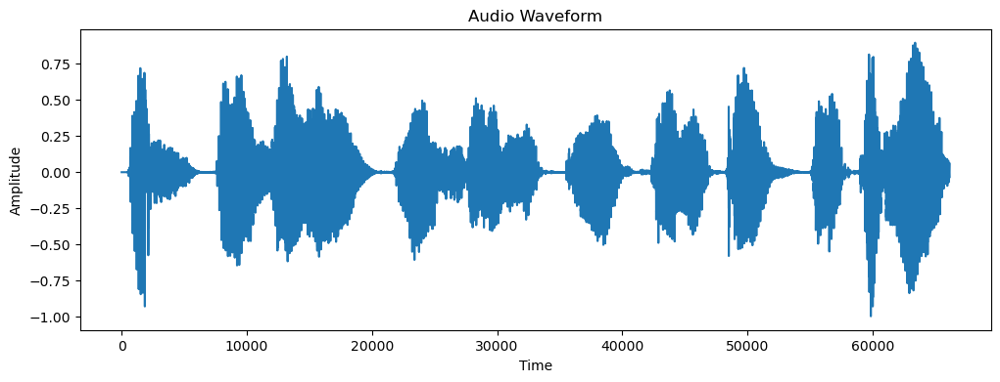

signal 13


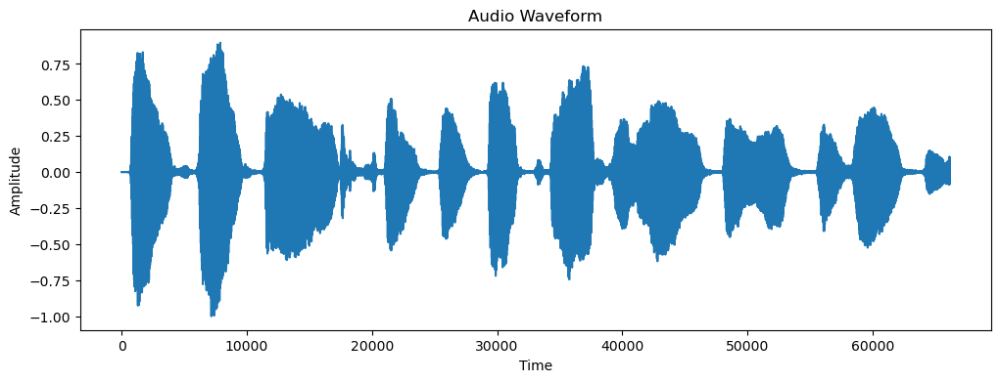

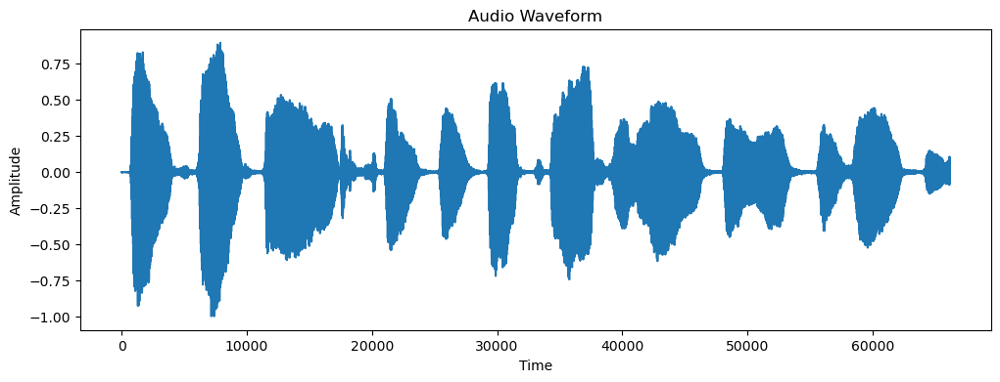

signal 15


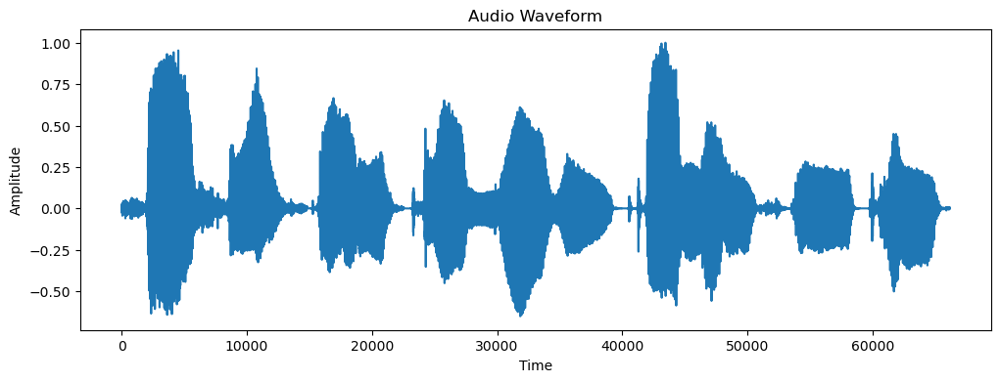

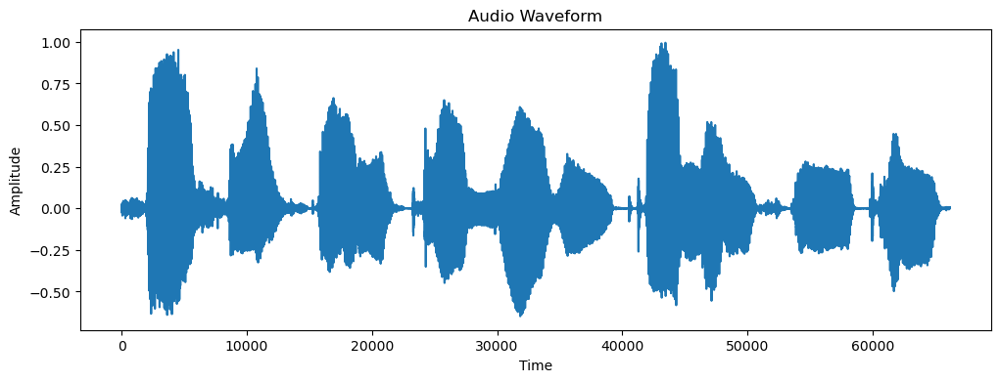

signal 18


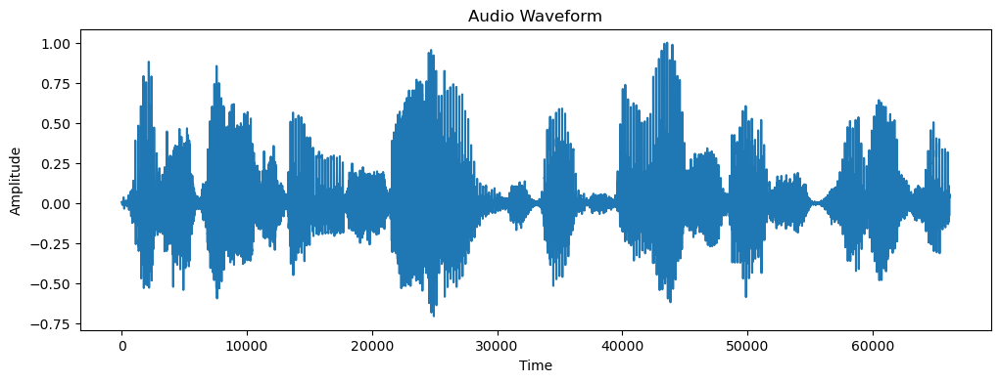

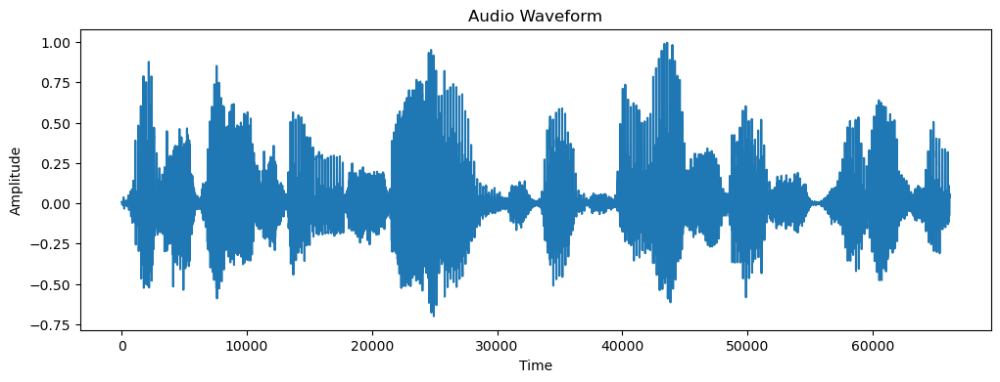

signal 22


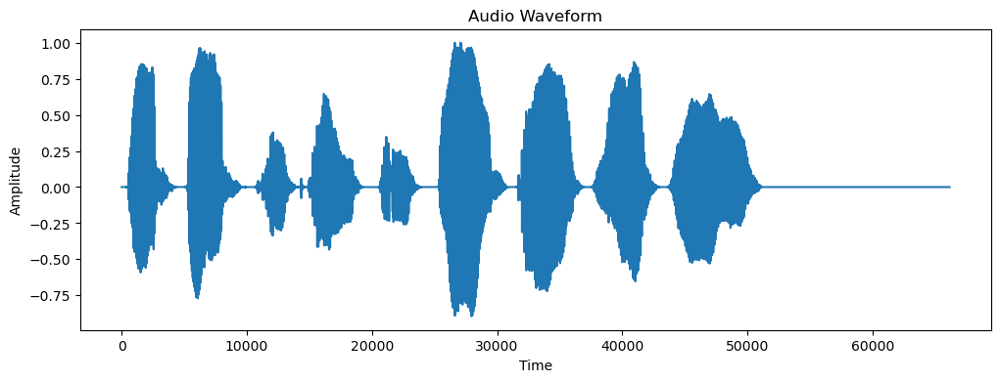

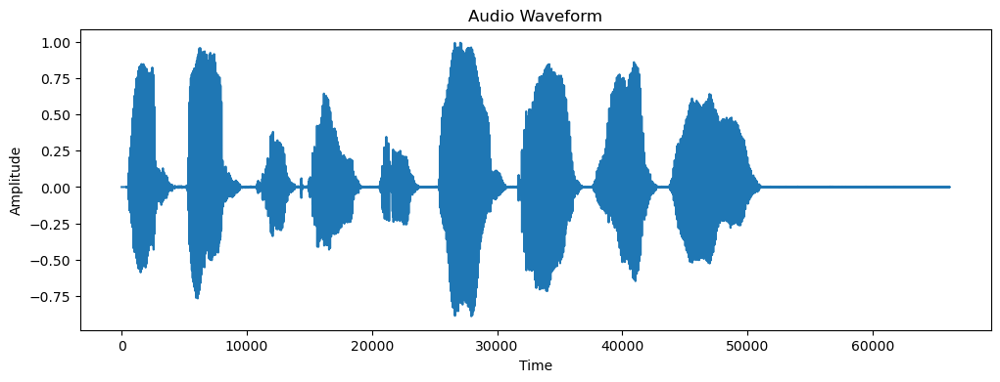

signal 25


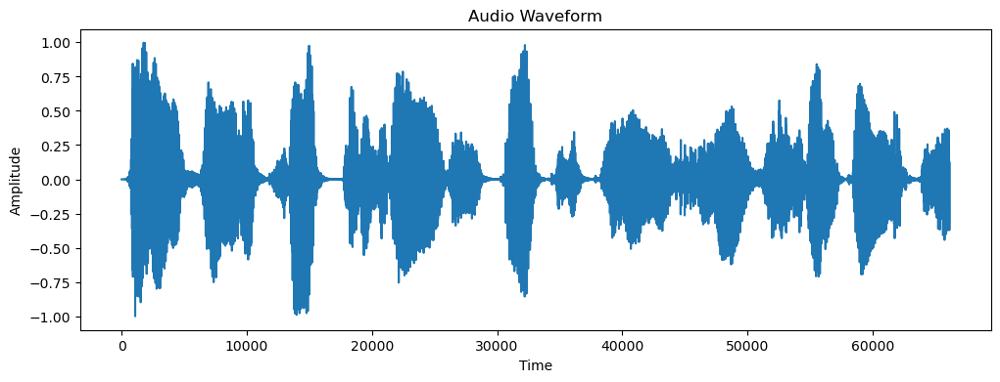

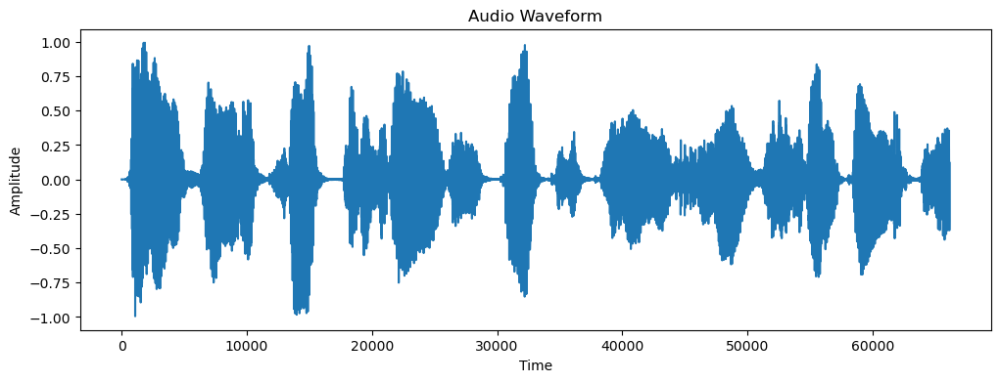

signal 26


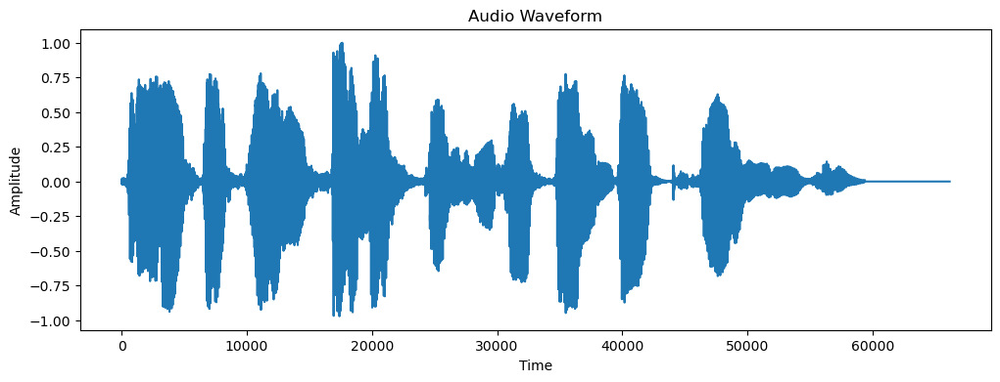

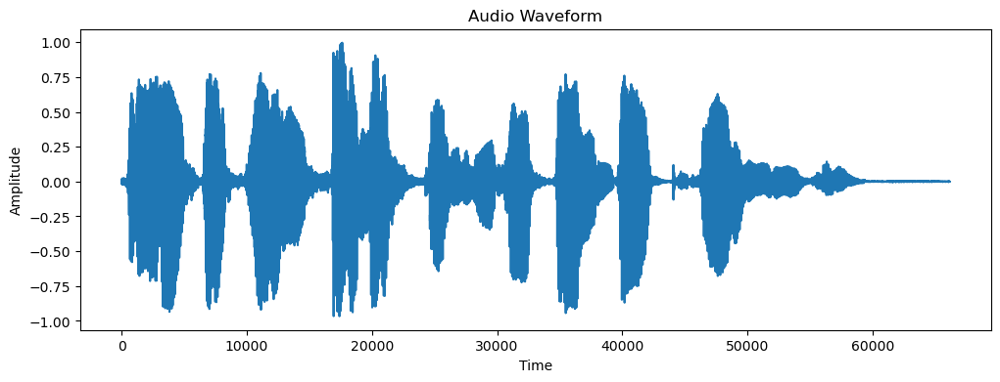

signal 28


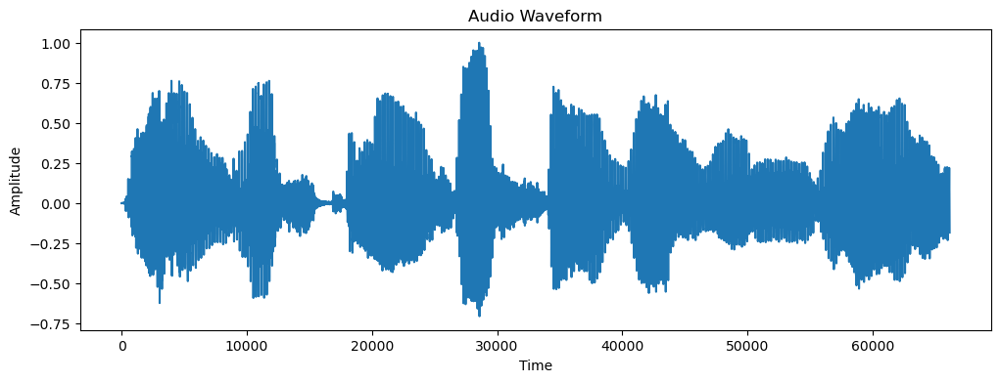

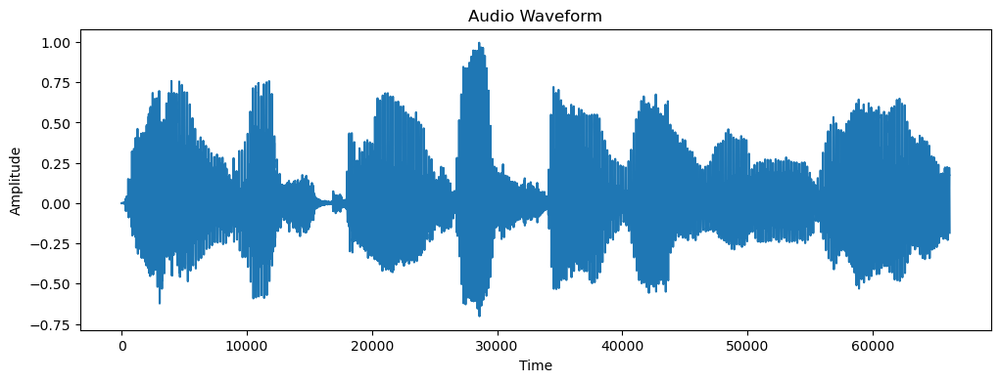

signal 34


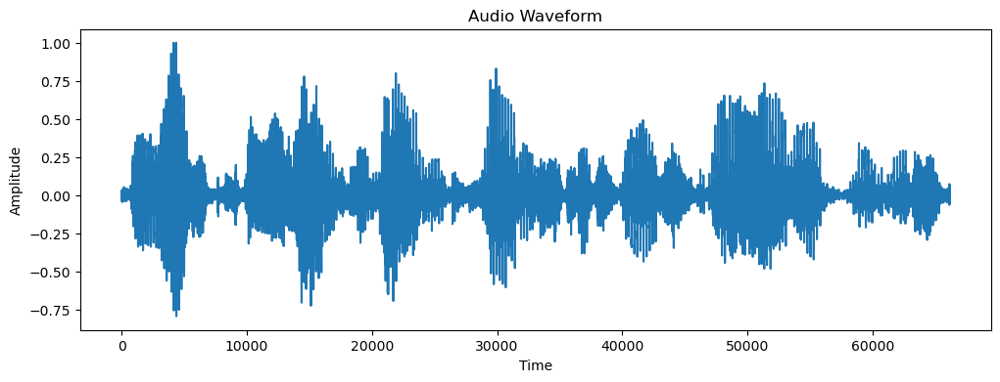

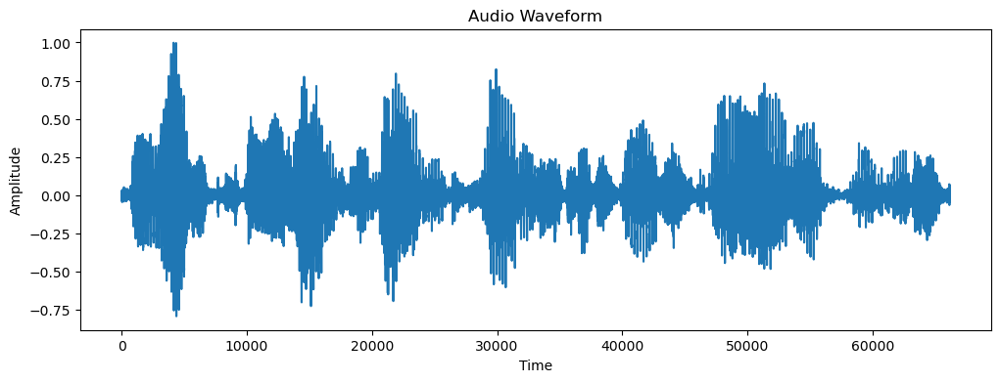

signal 35


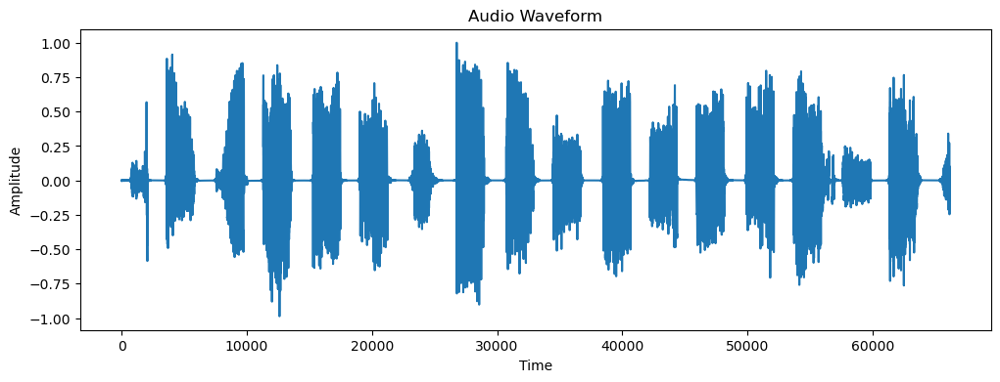

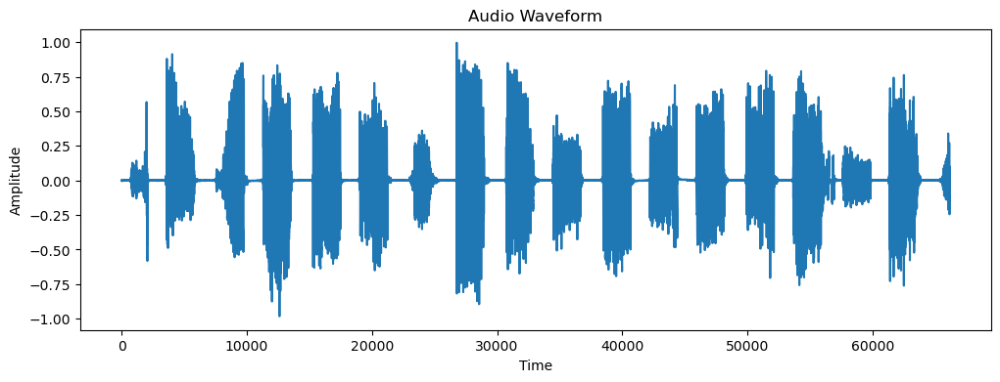

signal 37


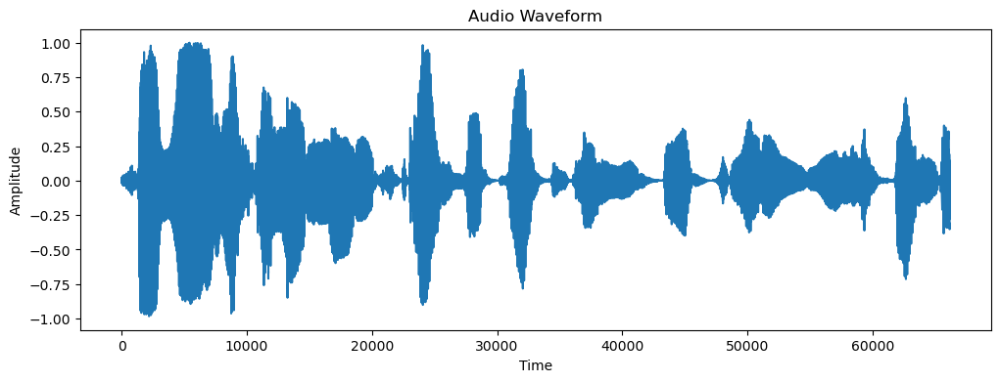

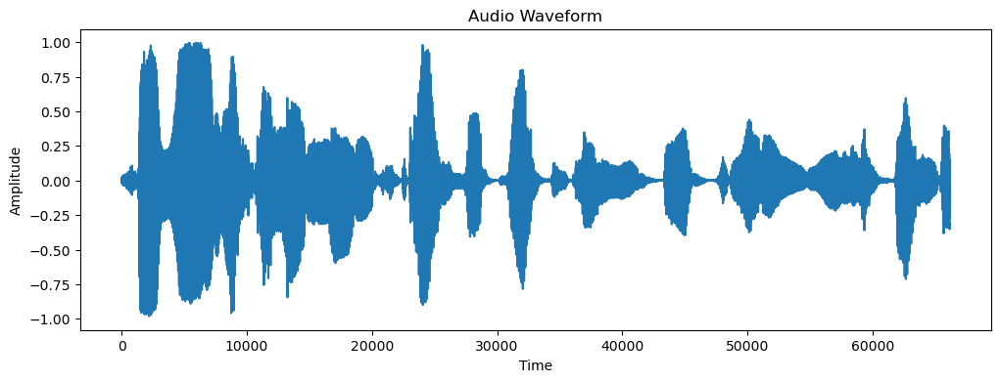

signal 39


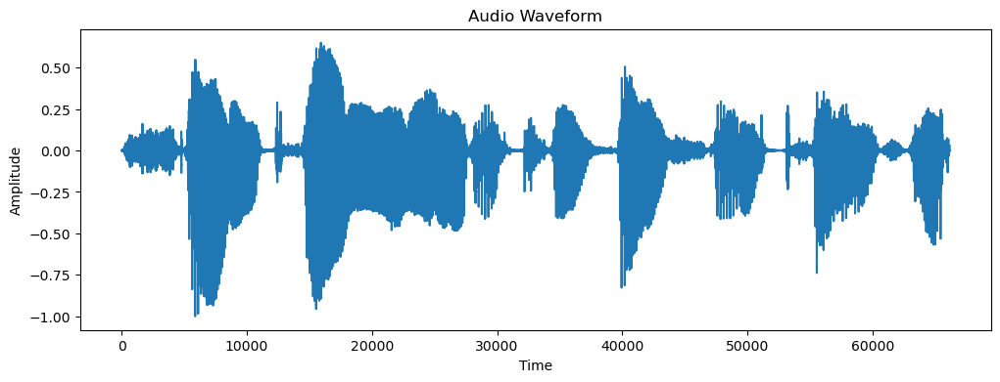

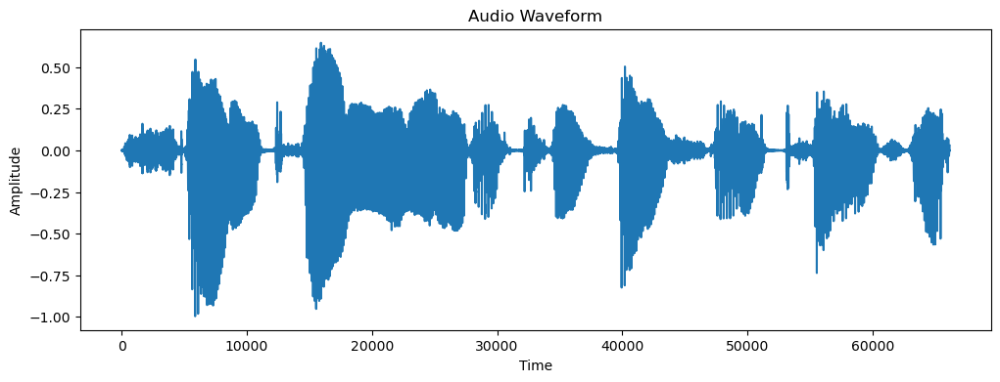

signal 42


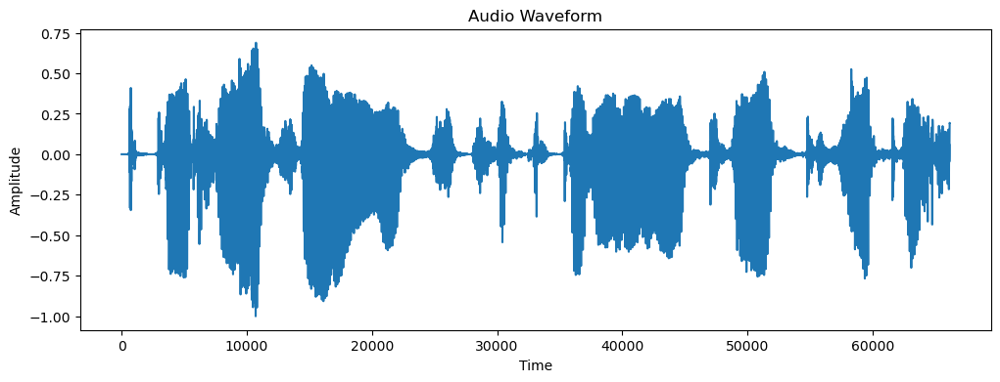

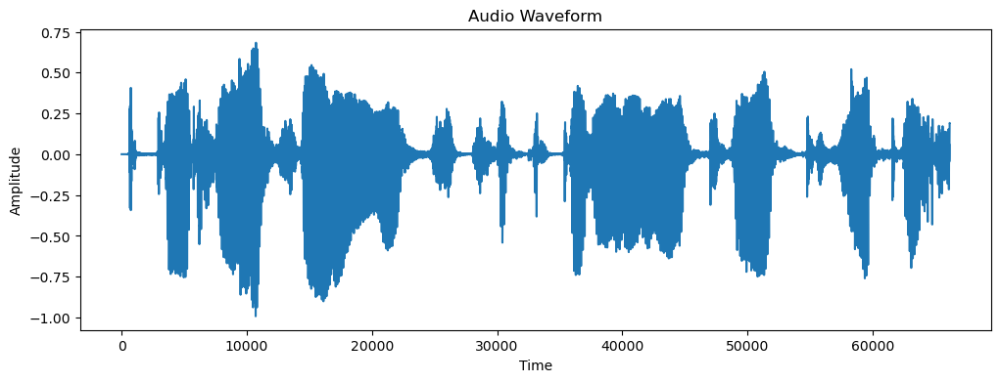

signal 46


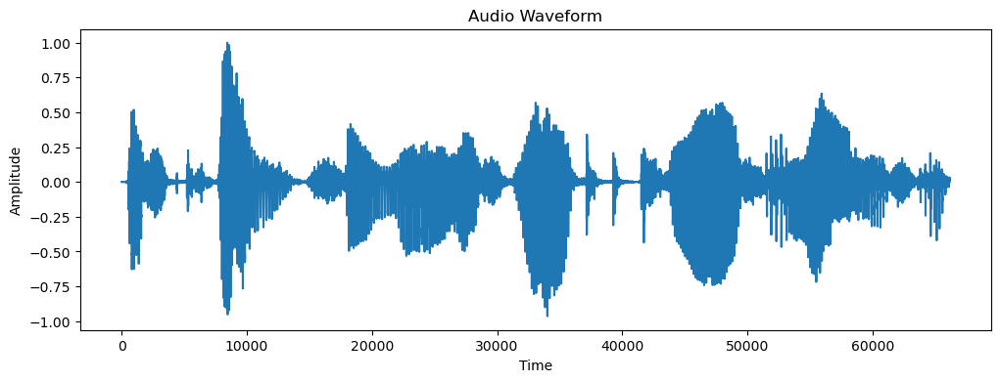

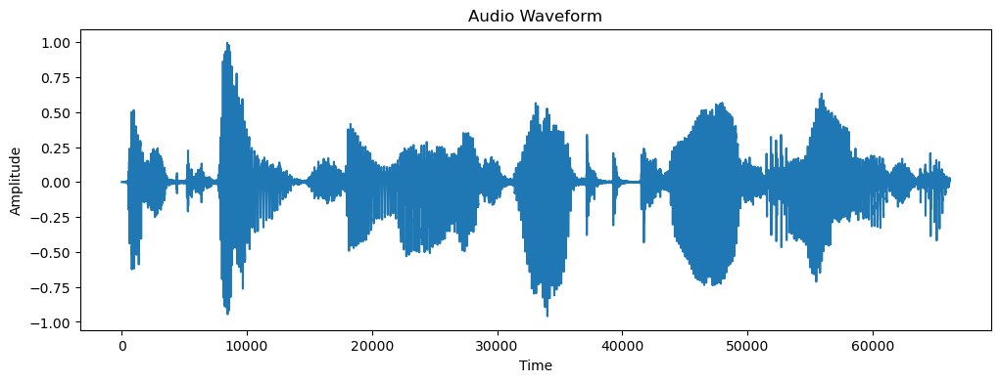

signal 47


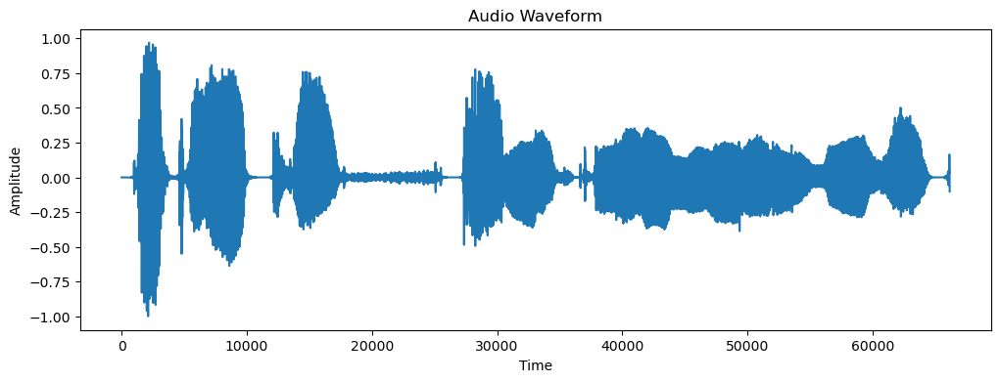

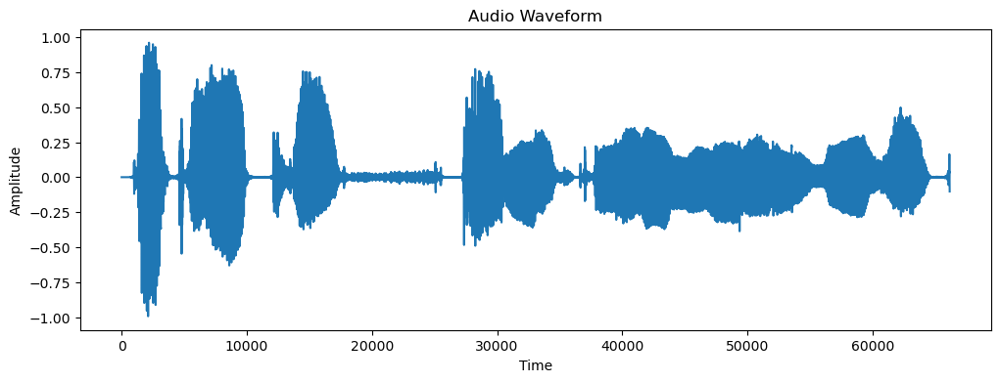

signal 48


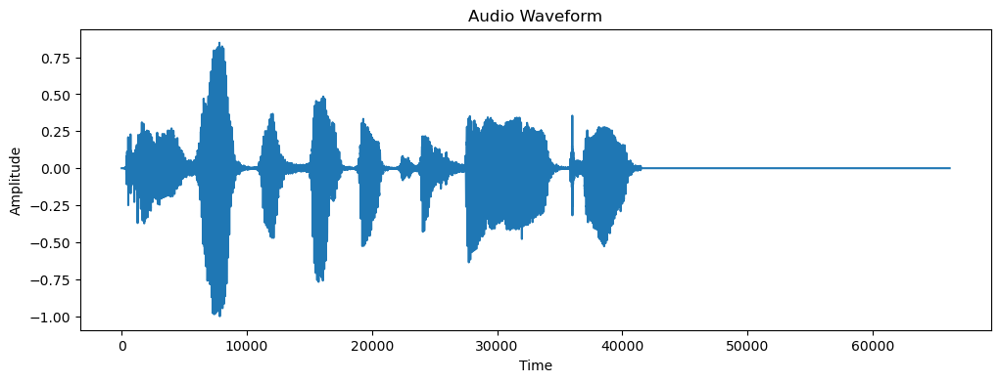

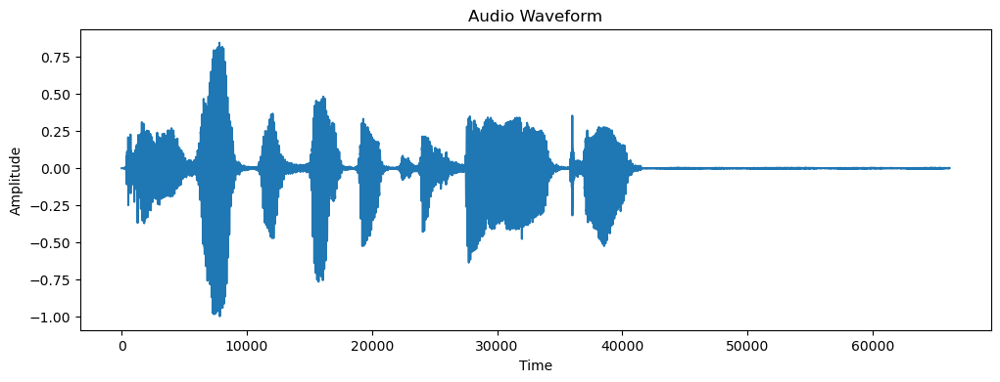

signal 50


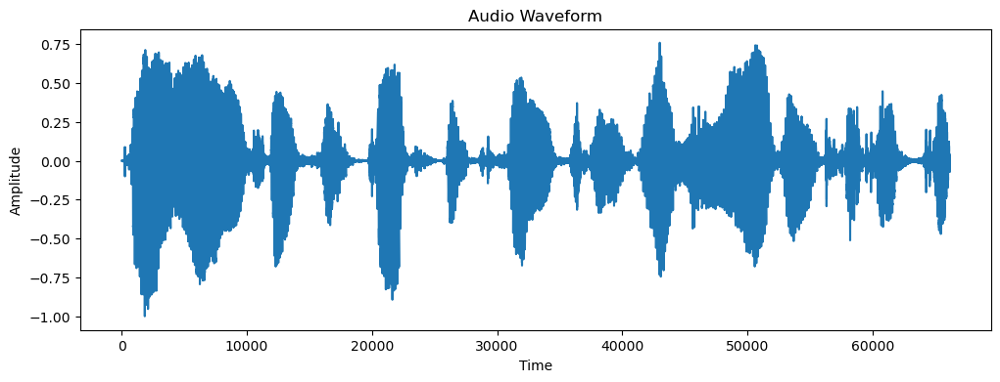

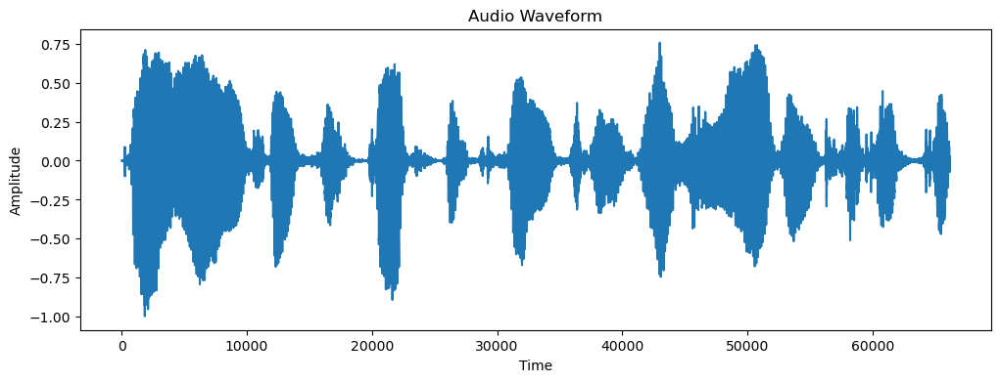

signal 51


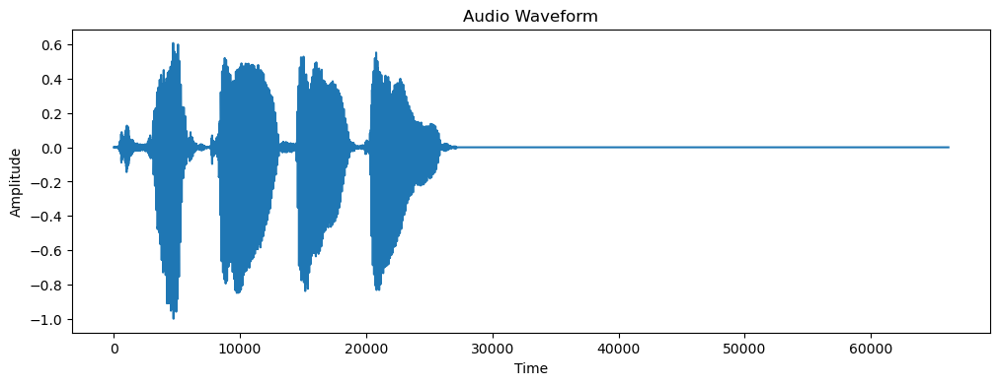

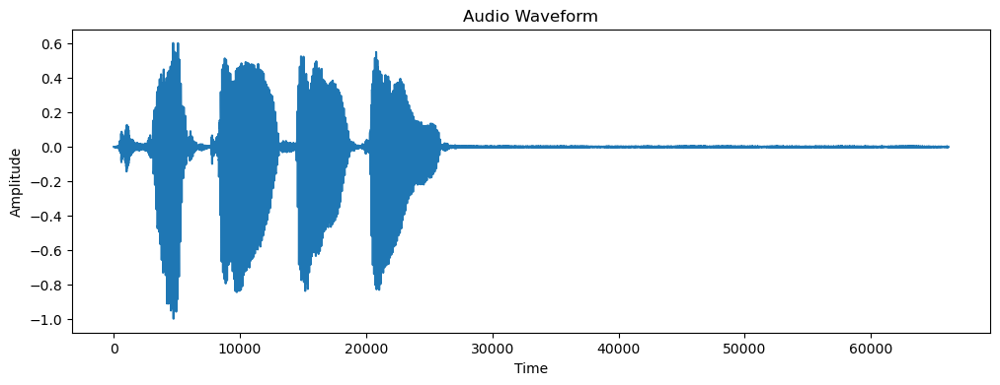

signal 52


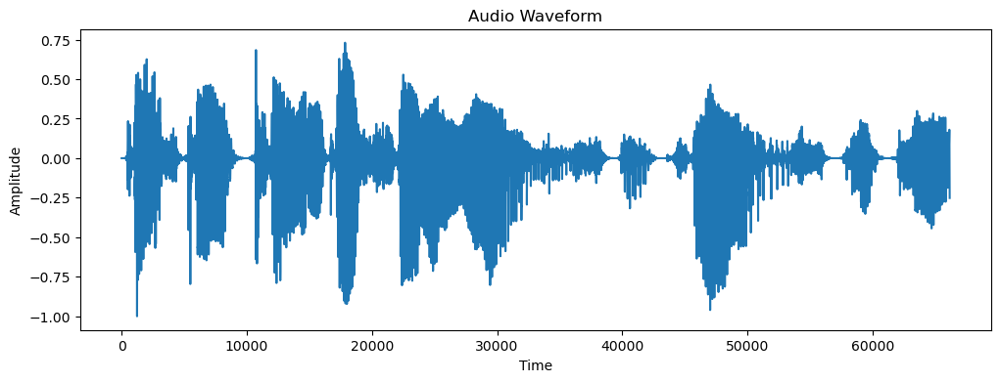

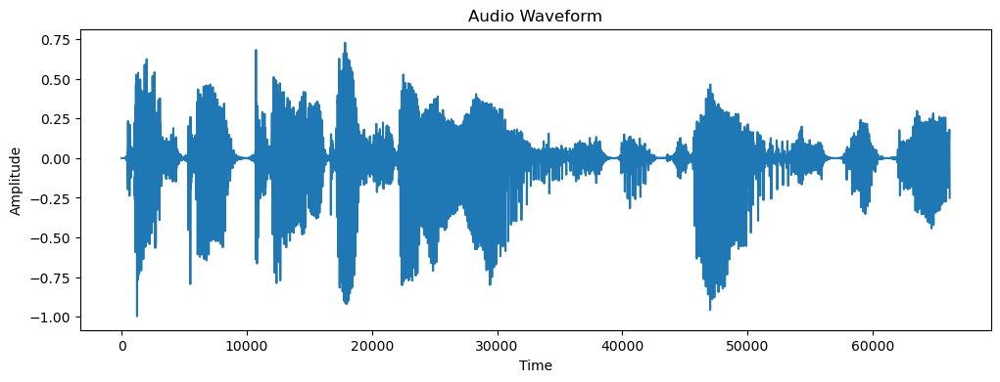

signal 53


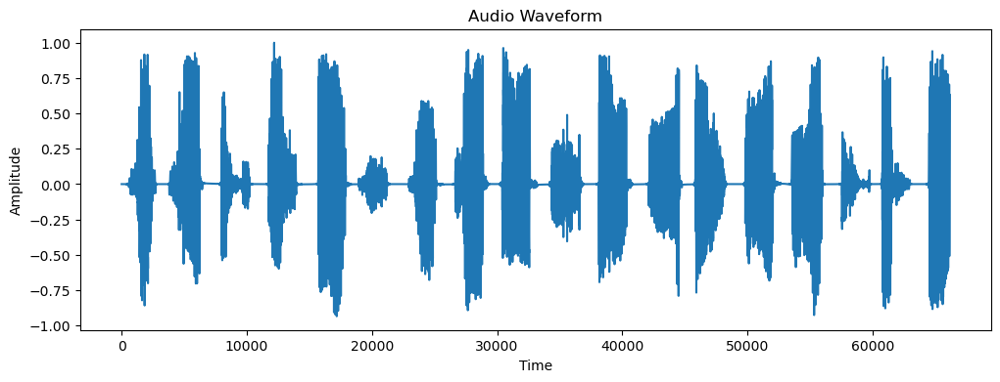

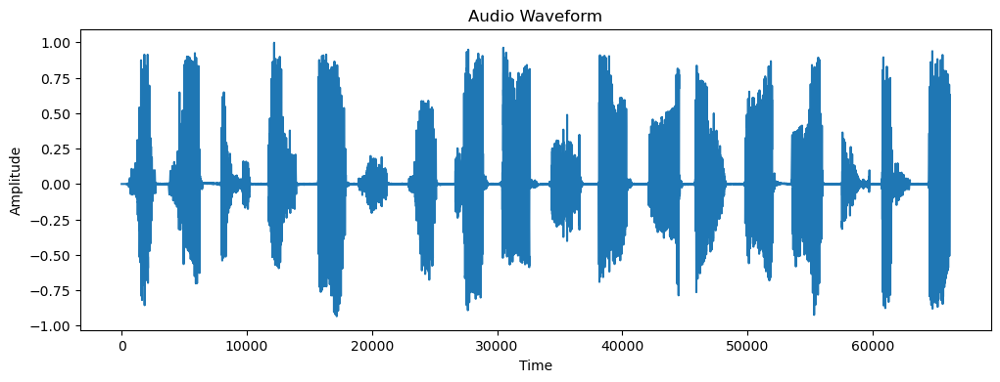

signal 54


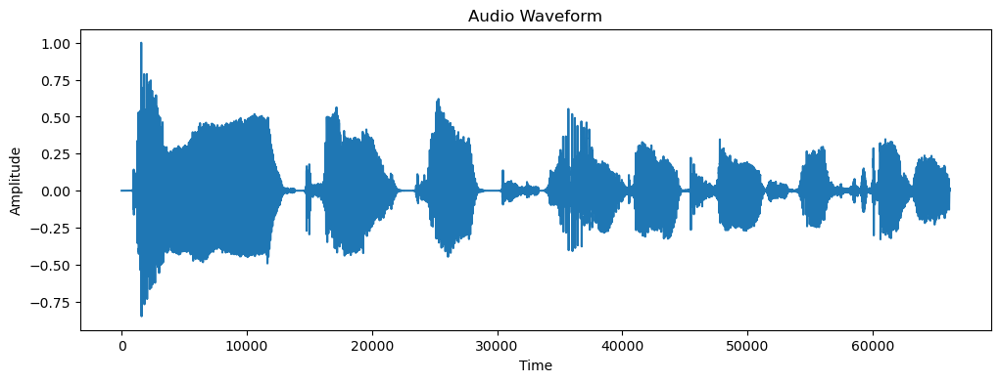

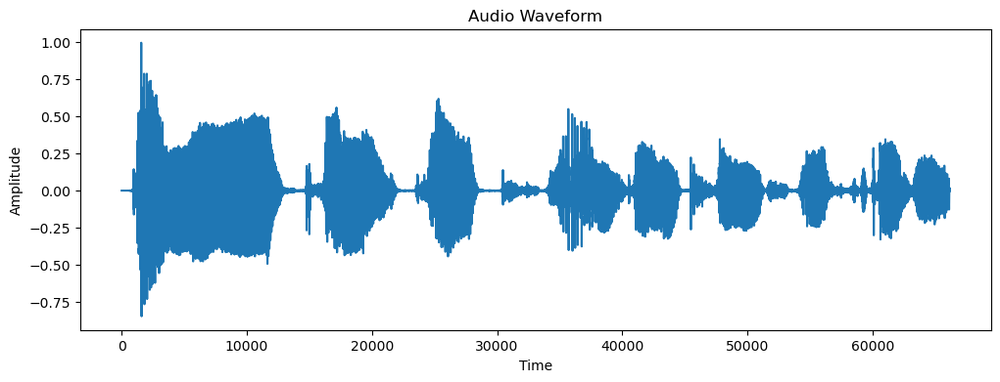

signal 55


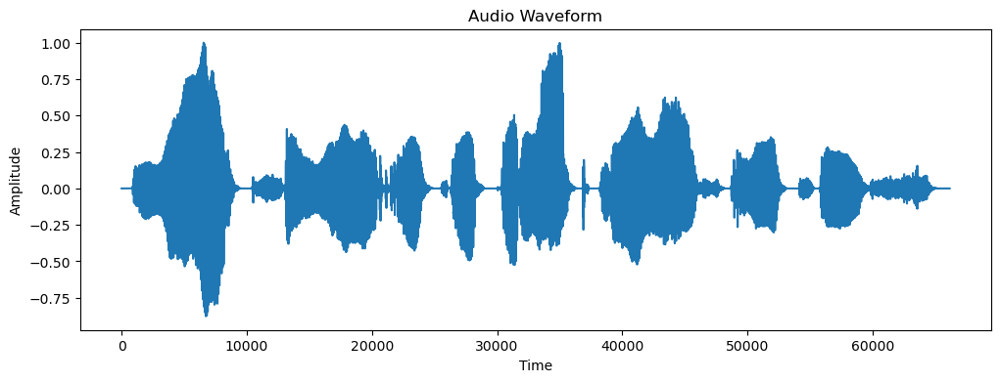

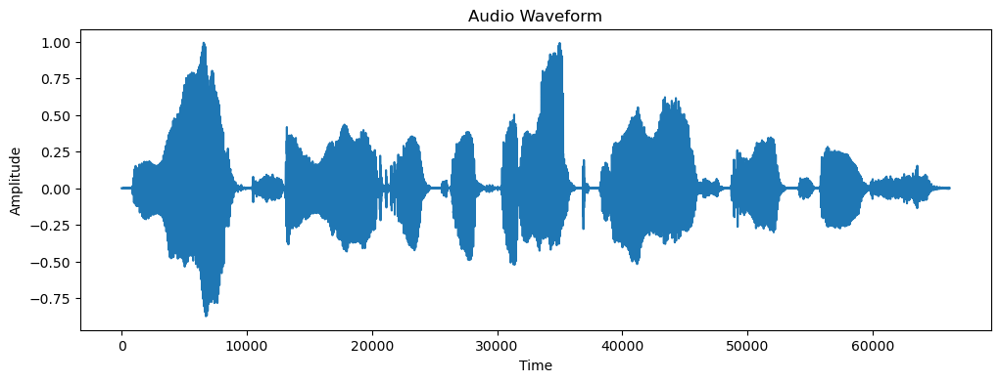

signal 59


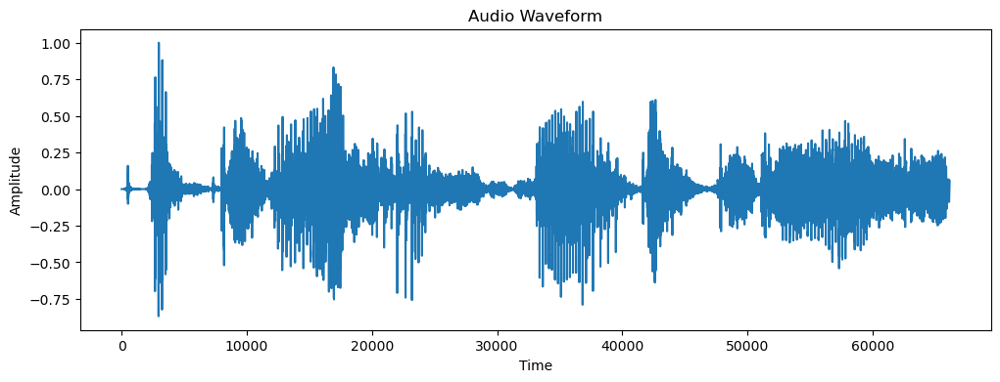

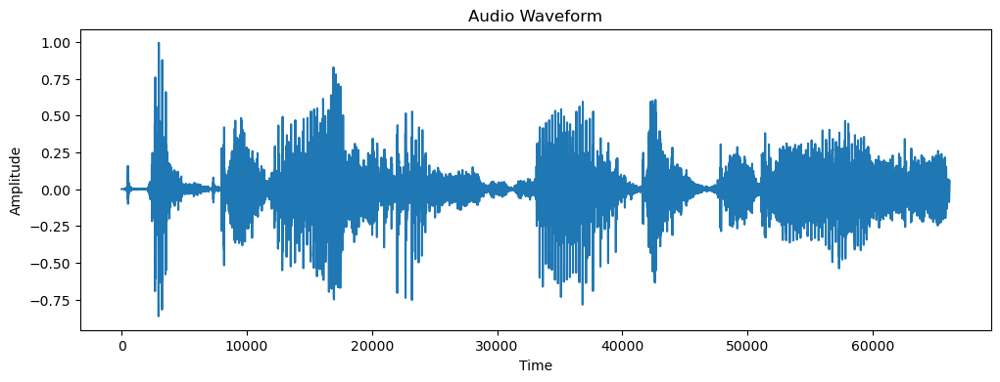

signal 61


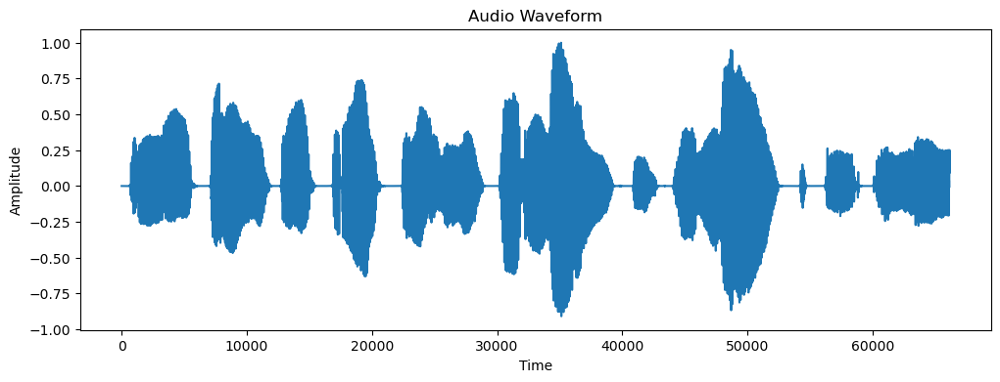

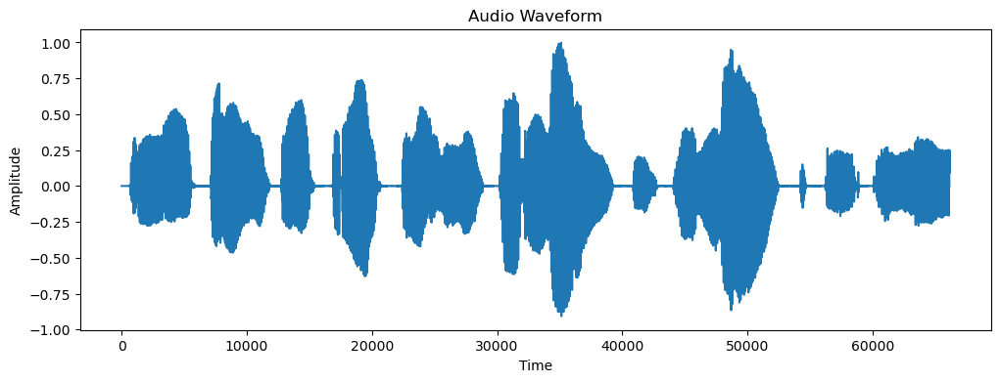

signal 62


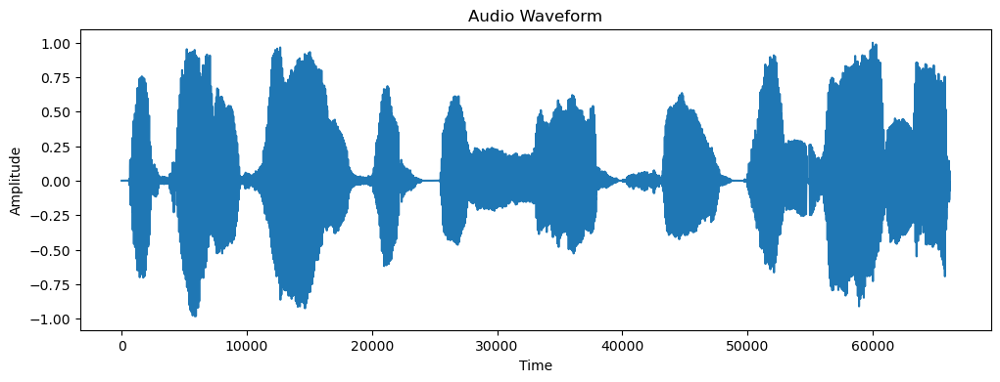

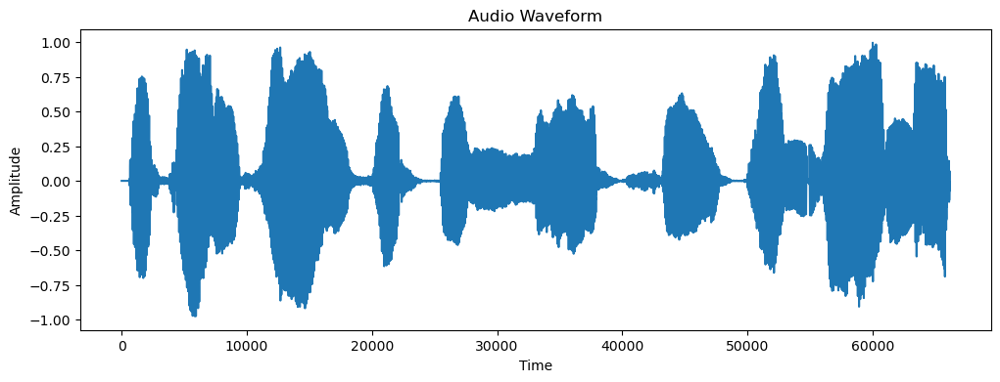

signal 65


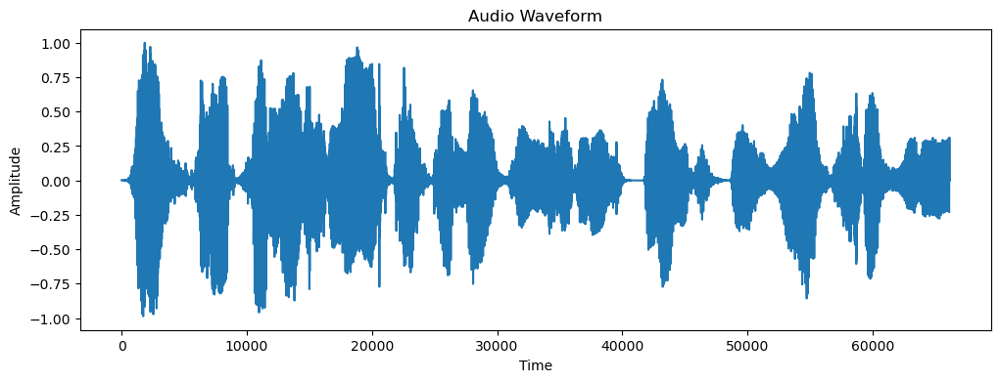

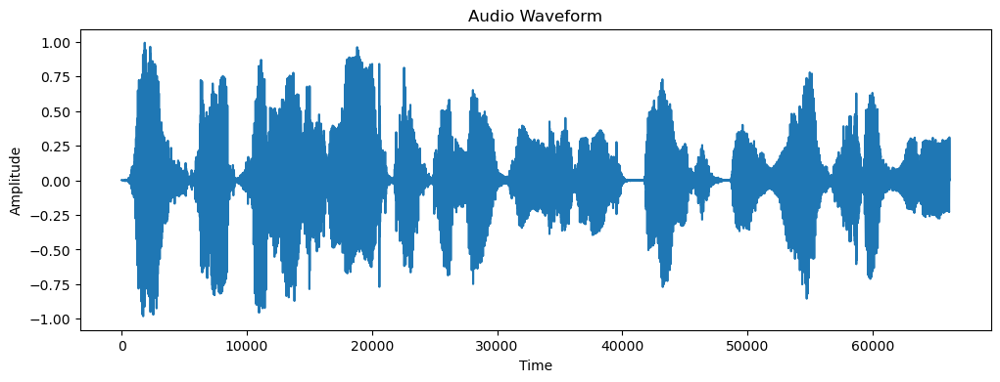

signal 66


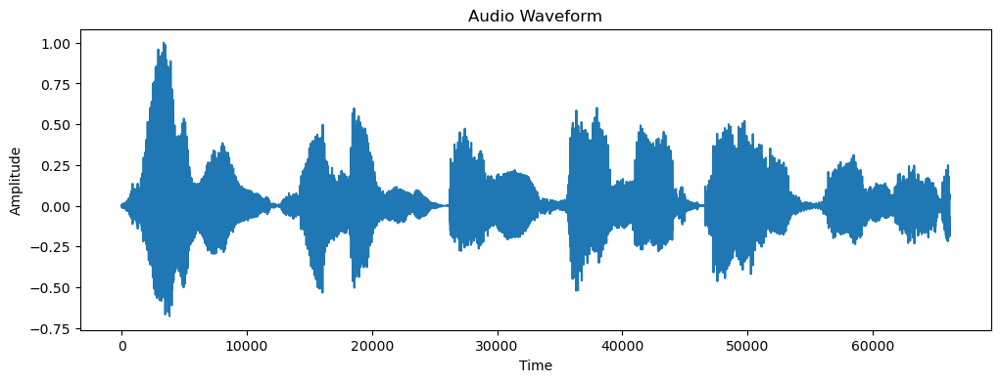

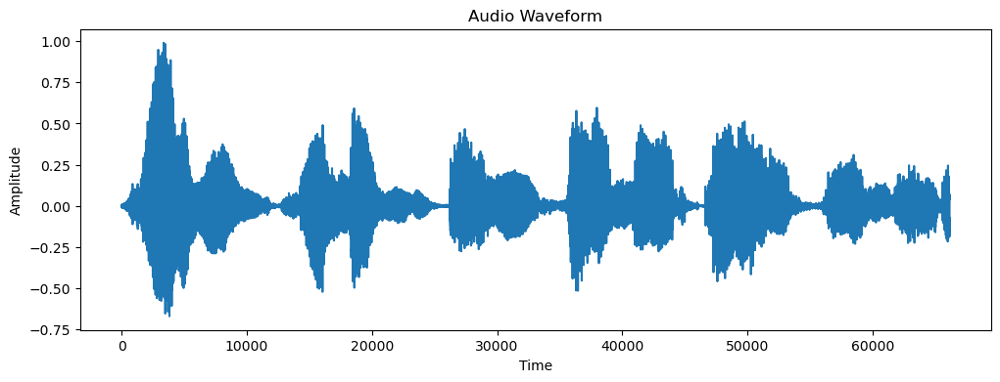

signal 68


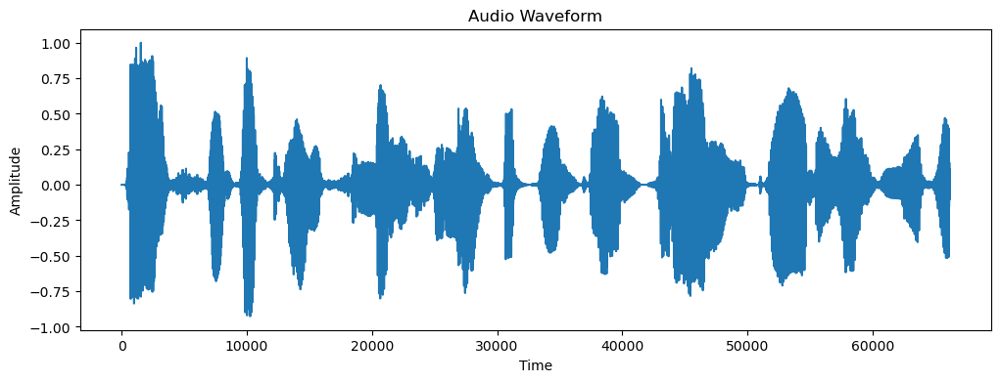

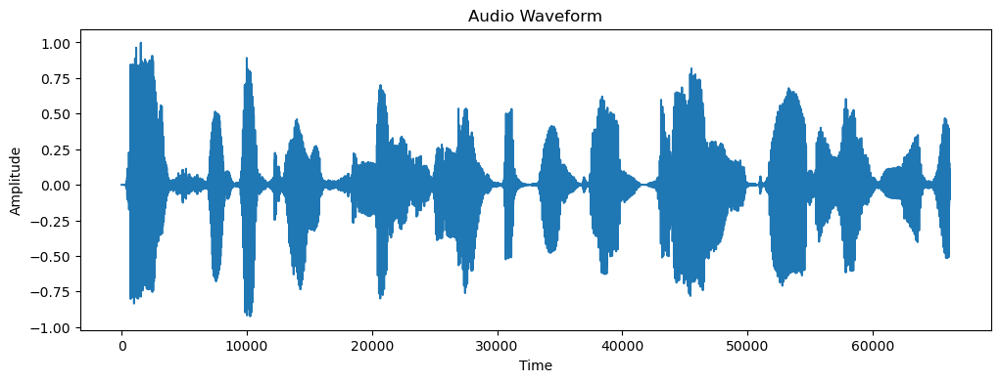

signal 70


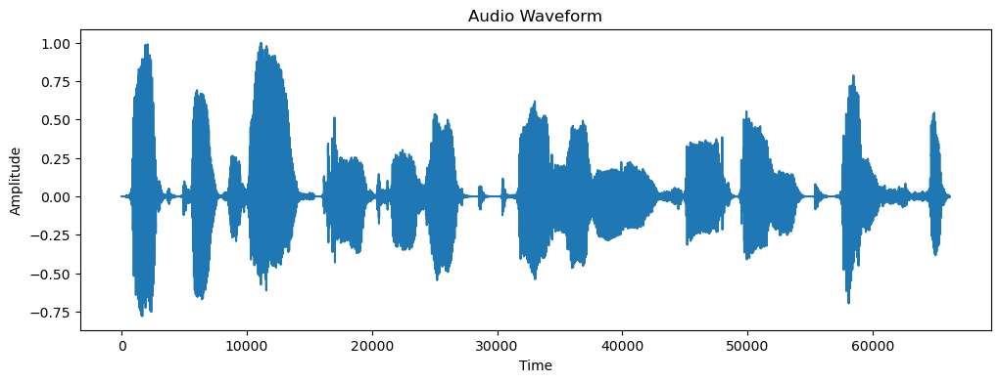

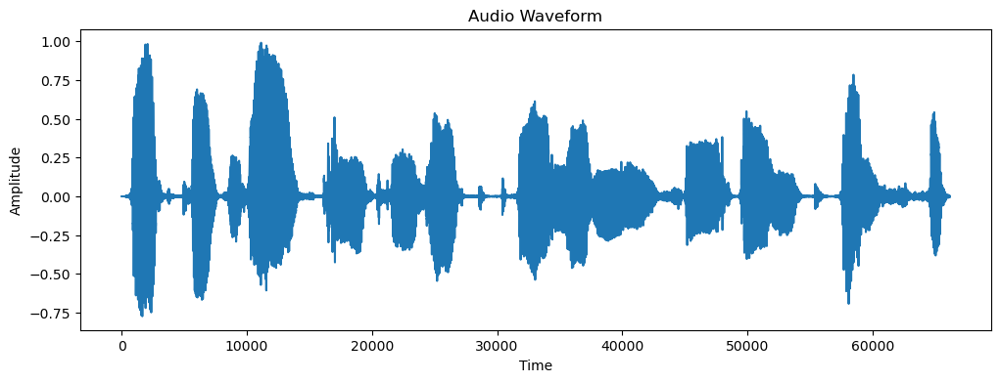

signal 73


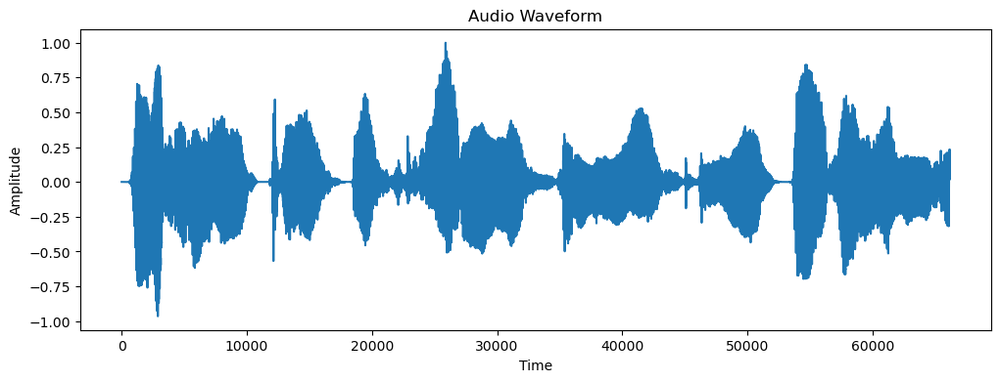

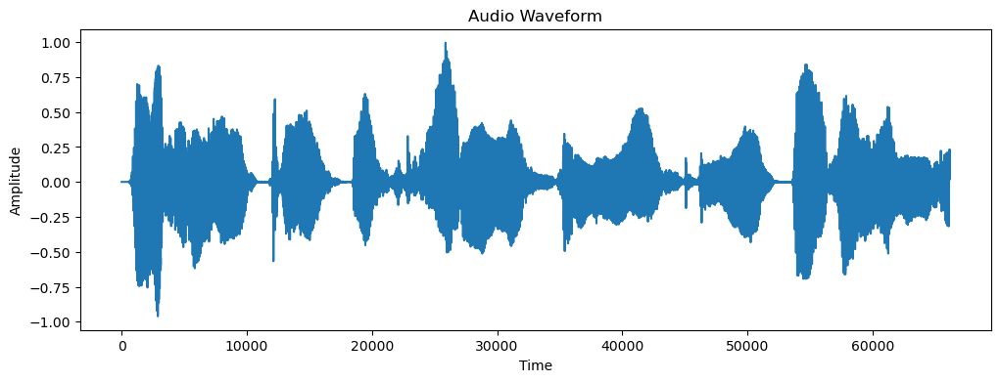

signal 77


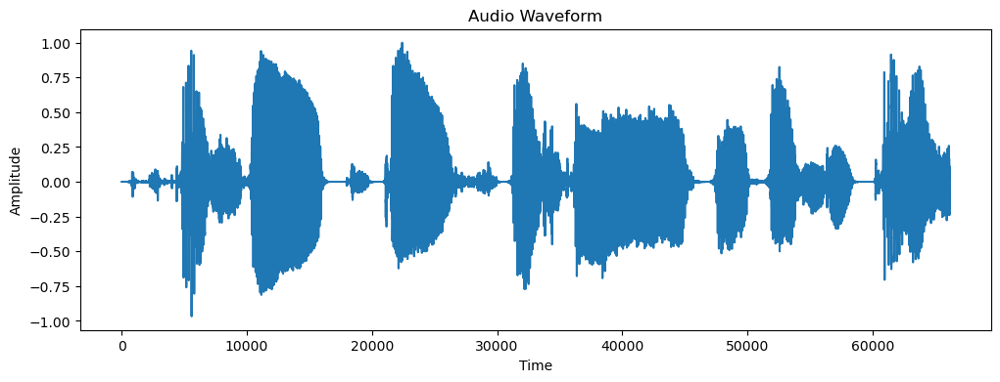

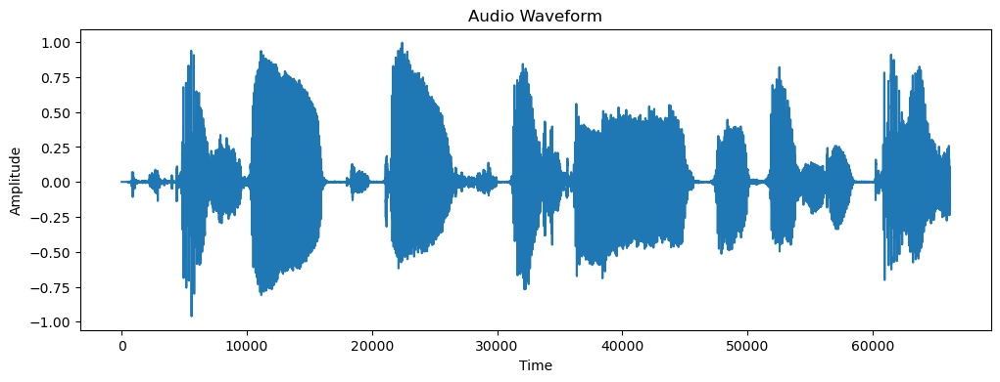

signal 78


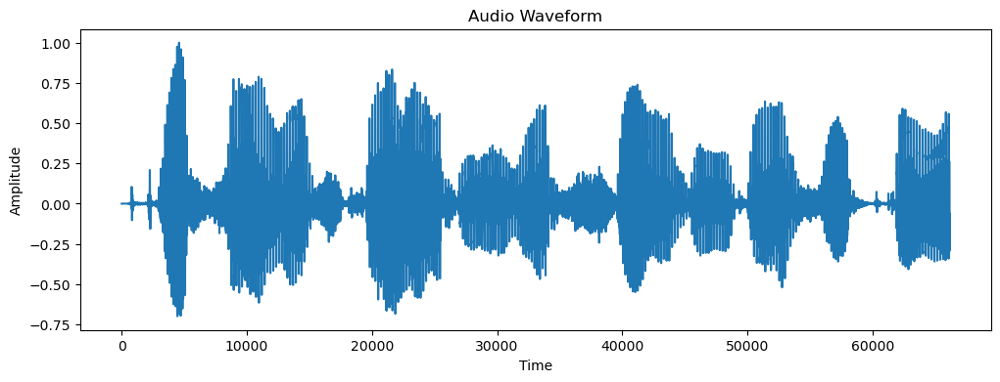

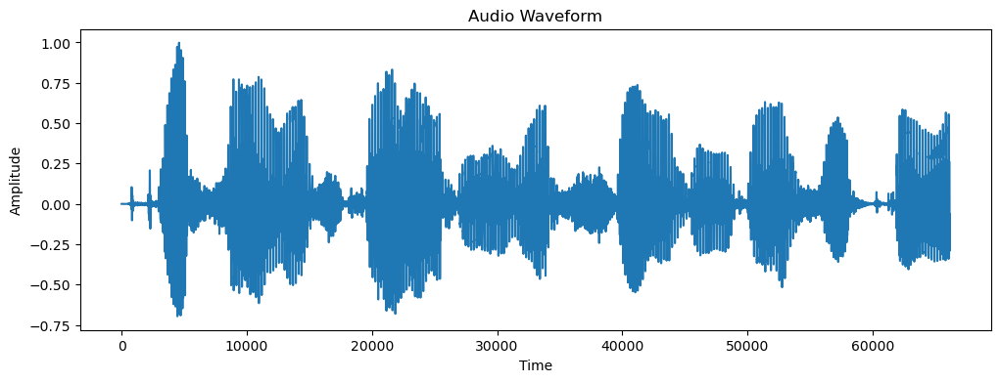

signal 79


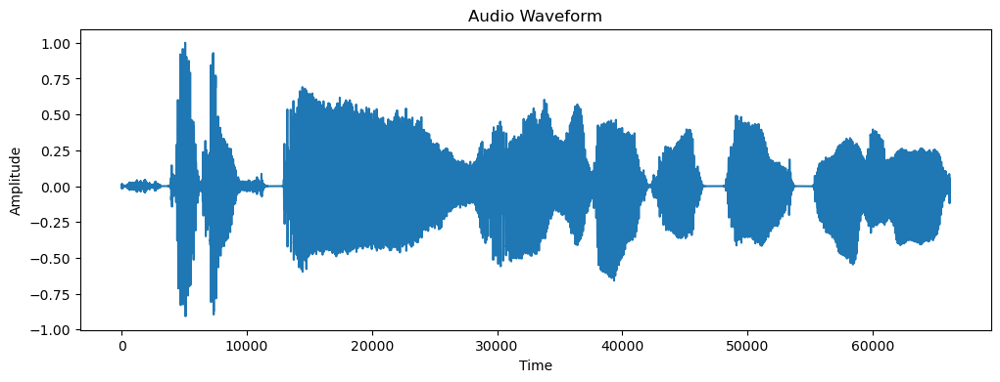

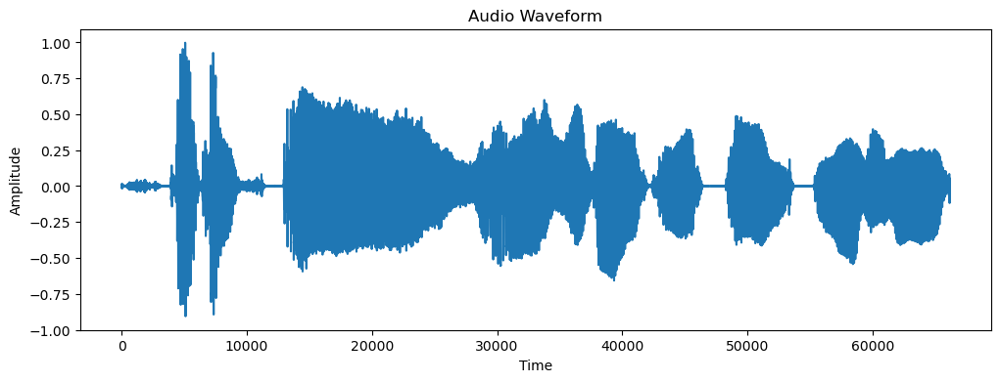

signal 86


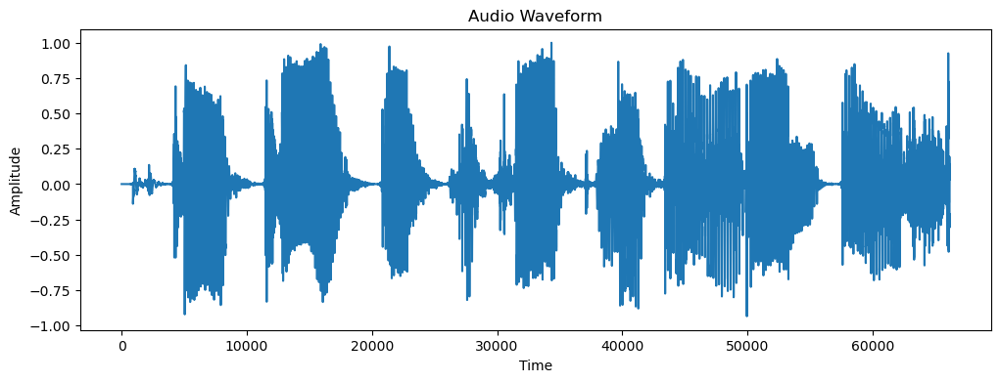

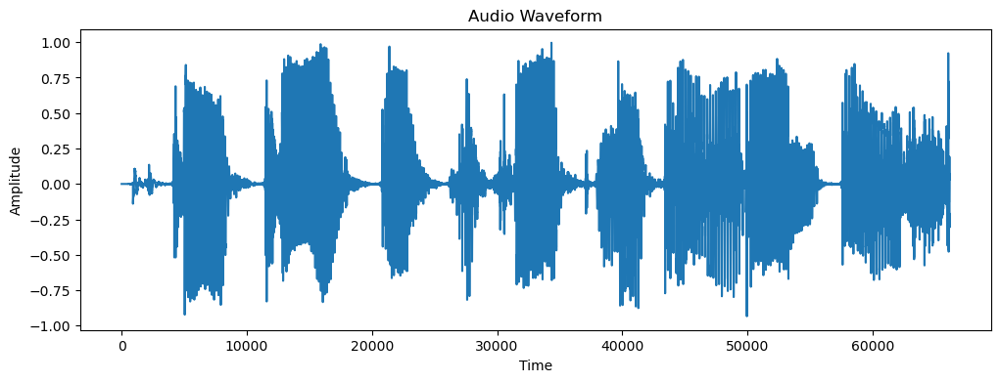

signal 87


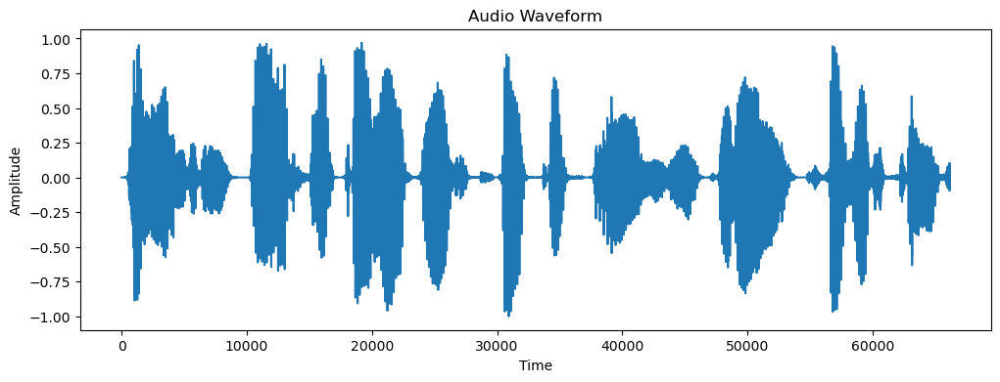

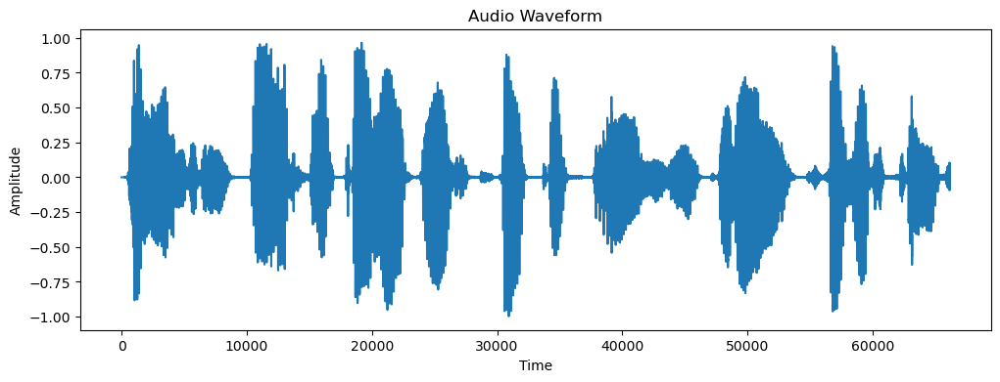

signal 88


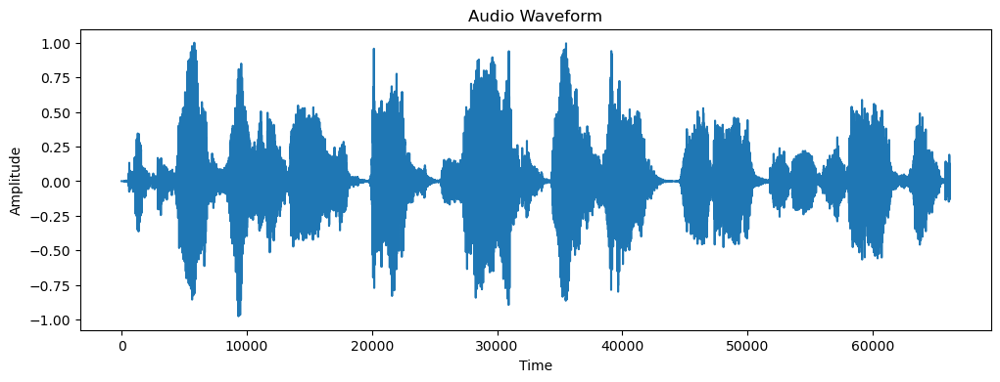

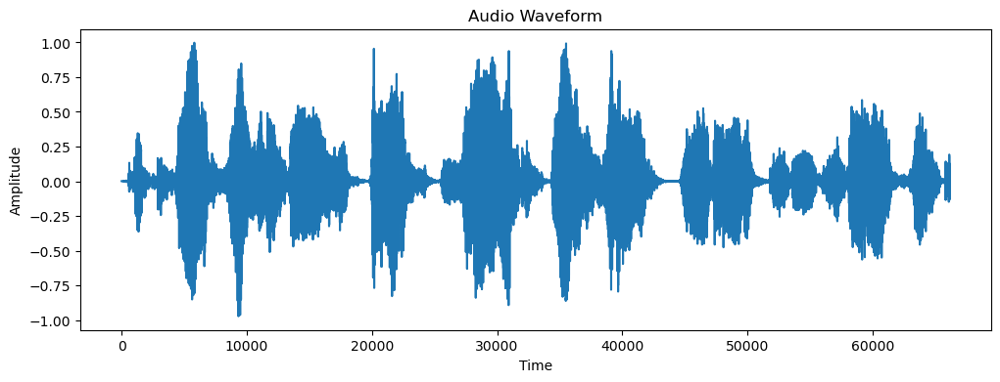

signal 89


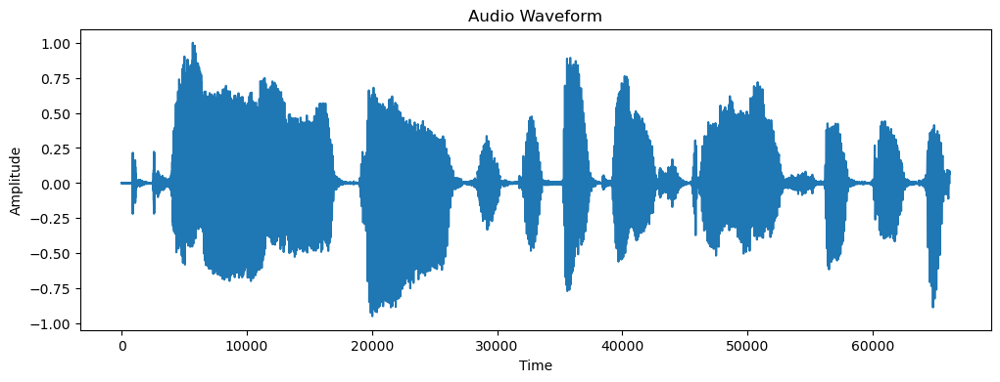

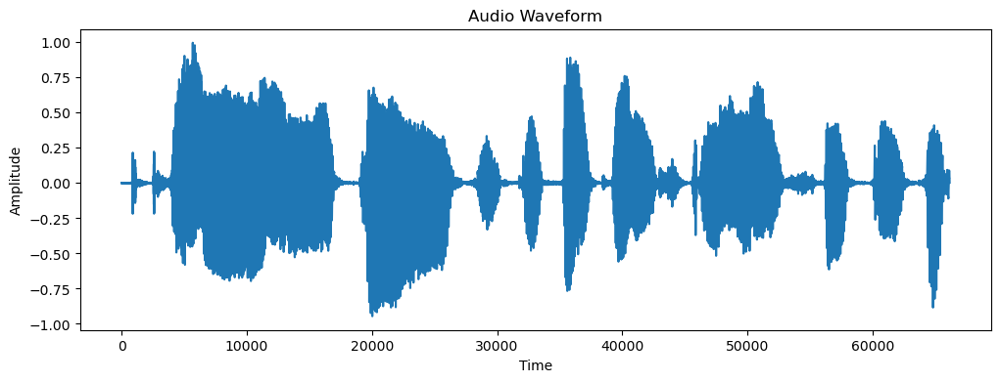

signal 92


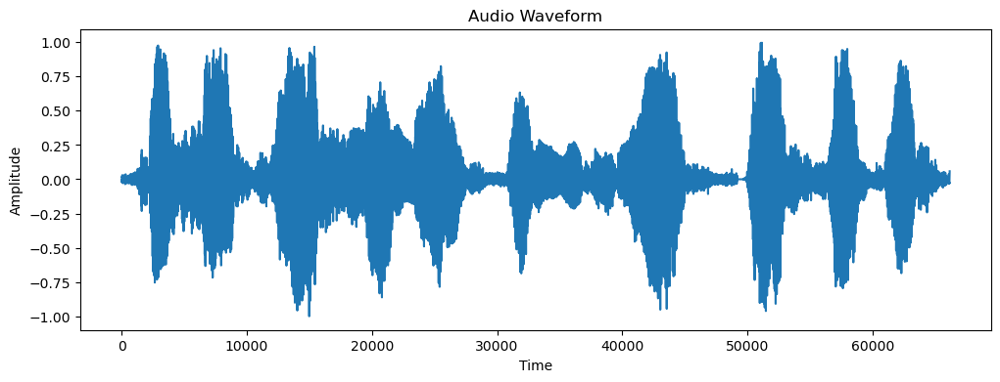

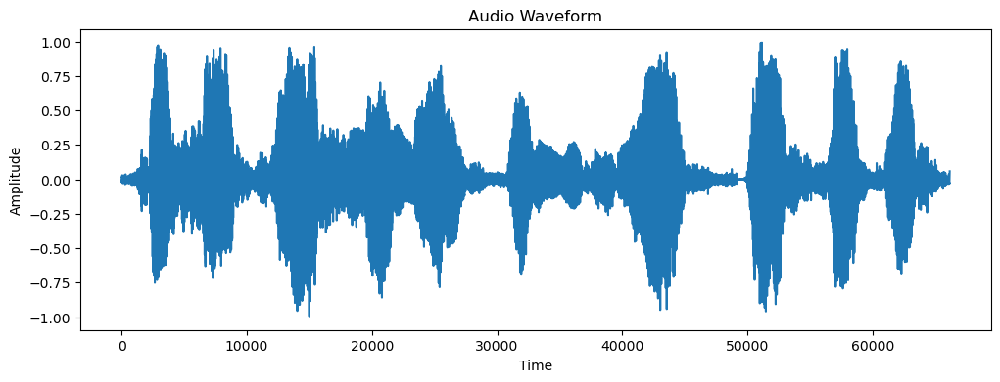

signal 94


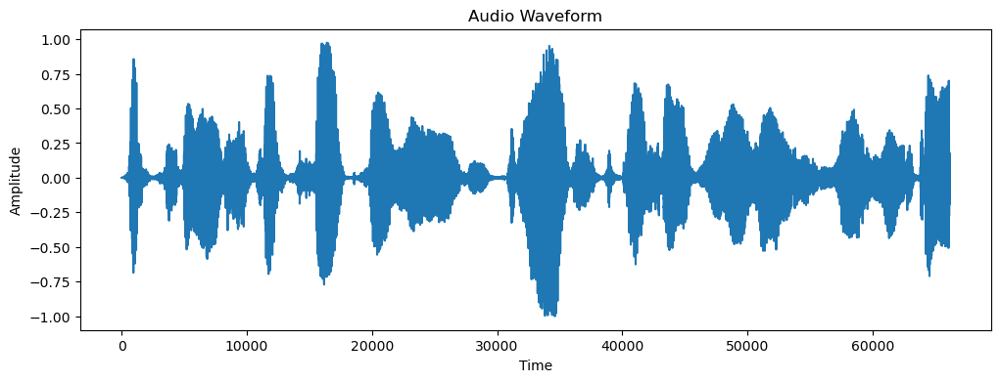

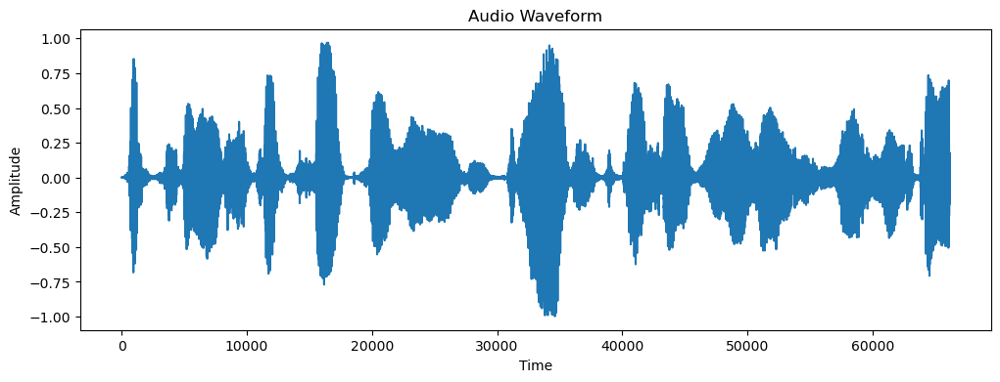

signal 95


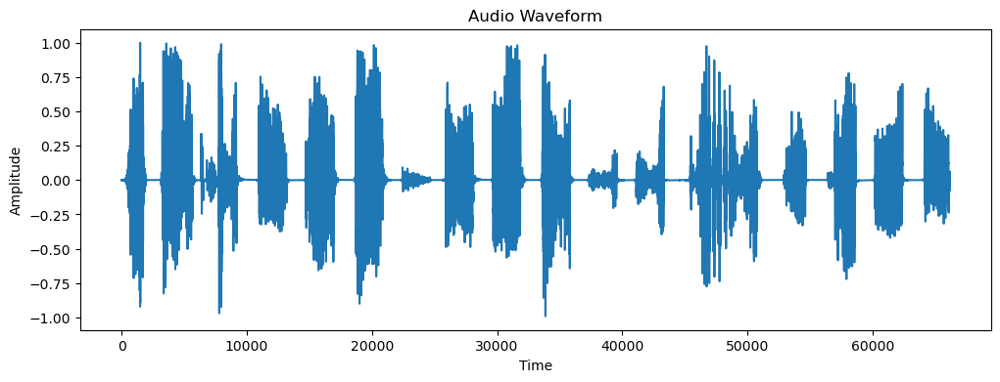

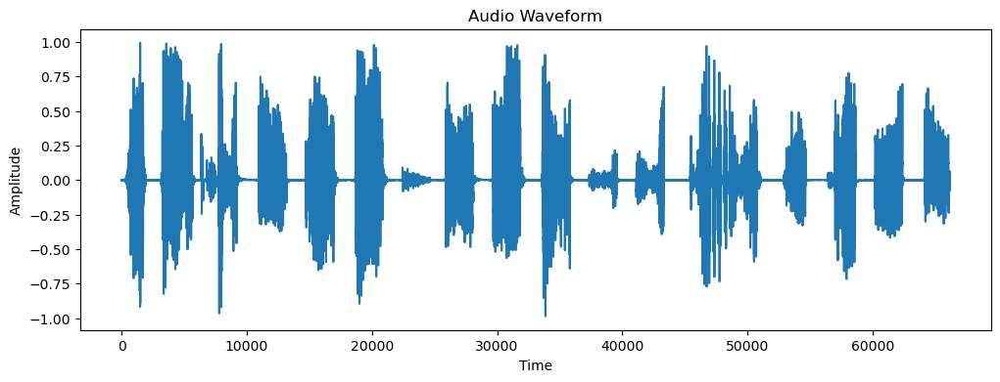

signal 96


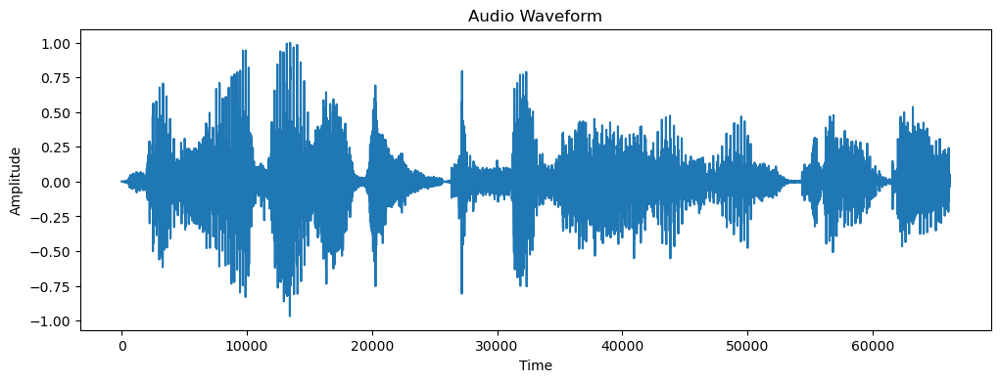

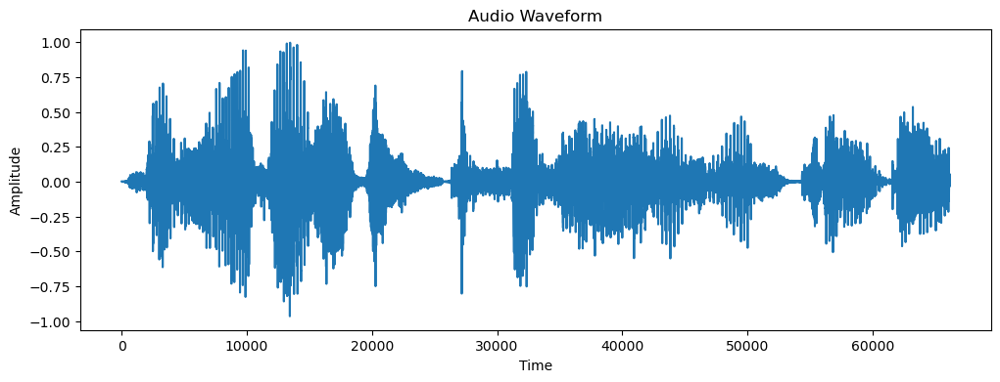

signal 97


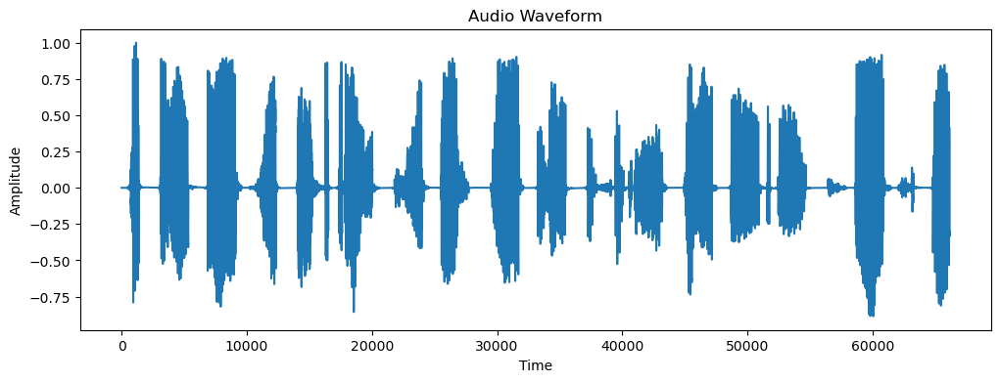

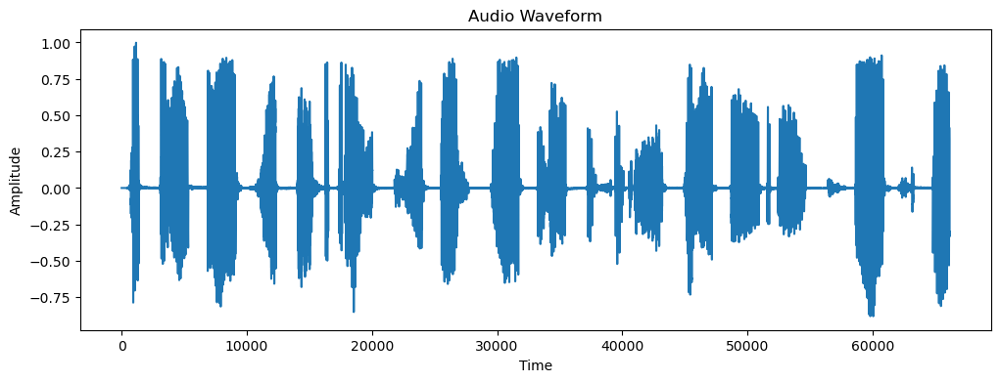

signal 99


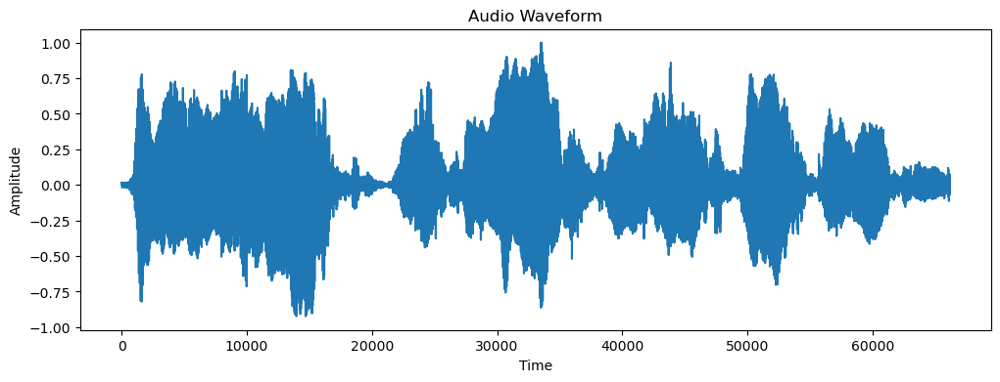

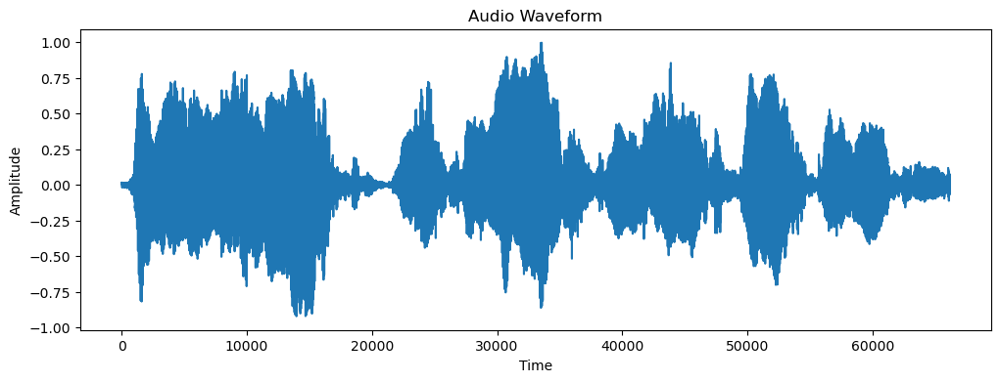

48


In [226]:

evaluator = Evaluation(dictionary)
j = 0
for i in range(100):
   reconstructed_signal = evaluator.reconstruct_signal(preprocessed_audios[i])
   distance = calculate_dtw_error(preprocessed_audios[i], reconstructed_signal)
   if distance < 2: 
      print(f"signal {i}")
      visualizer = AudioVisualizer(preprocessed_audios[i])
      visualizer.show()
      visualizer = AudioVisualizer(reconstructed_signal)
      visualizer.show()
      j += 1
print(j)   
   
   
   
   



In [236]:
# Example usage
noise_adder = NoiseAdder('C:\\Users\\frank\\Online dictionnary learning spard coding\\data\\UrbanSound8K\\UrbanSound8K\\audio\\fold1')

noised_signal = noise_adder.match_length_and_add_noise(preprocessed_audios[99], sr = None)


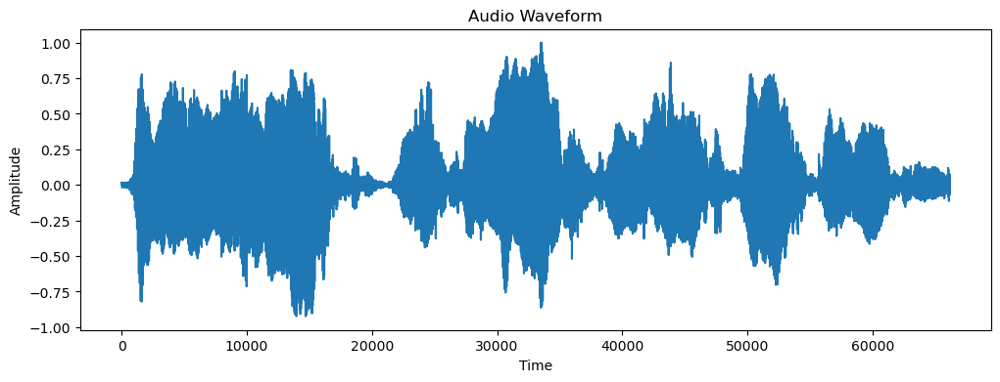

In [235]:
visualizer = AudioVisualizer(preprocessed_audios[99])
visualizer.show()

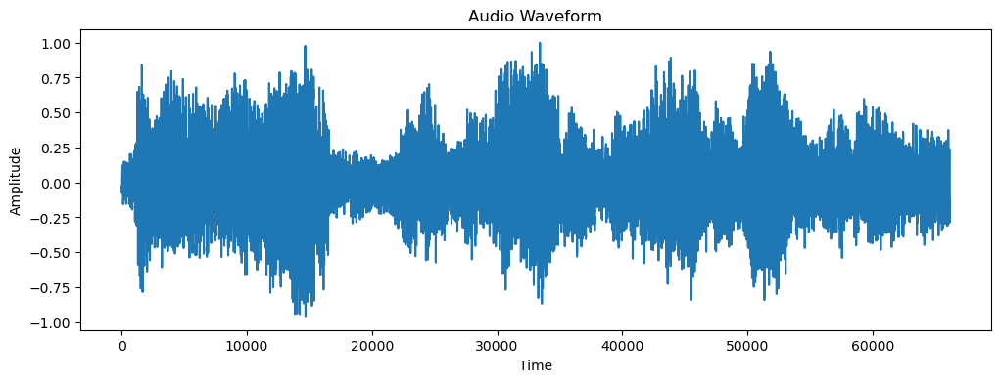

In [237]:
visualizer = AudioVisualizer(noised_signal)
visualizer.show()

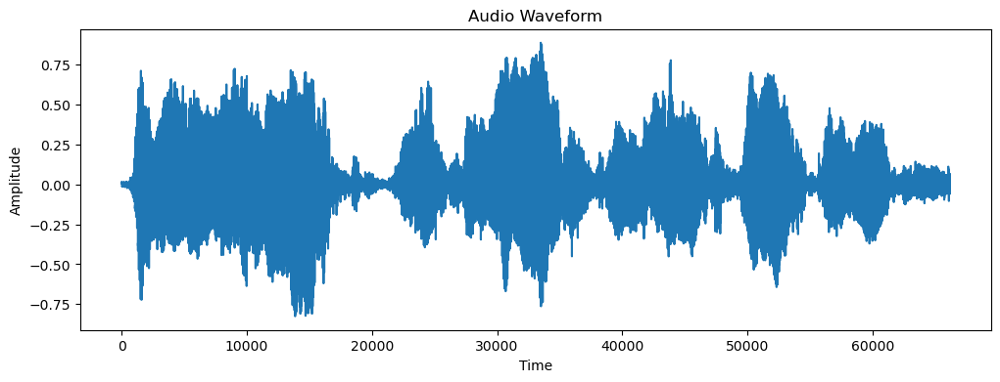

In [238]:
reconstructed_signal = evaluator.reconstruct_signal(noised_signal)
visualizer = AudioVisualizer(reconstructed_signal)
visualizer.show()

In [215]:
def calculate_dtw_error(original_signal, reconstructed_signal):
    alignment = np.linalg.norm(original_signal - reconstructed_signal)
    return alignment

In [119]:
param_grid = {
    'n_components': [30, 32, 40, 50],
    'alpha': [1, 2, 3,8],
    'max_iter': [900, 1000, 1200],
    'batch_size': [10, 15, 20, 18]
}


In [121]:
best_params = None
best_error = float('inf')

# Iterating over the parameter grid
for n_components in param_grid['n_components']:
    for alpha in param_grid['alpha']:
        for max_iter in param_grid['max_iter']:
            for batch_size in param_grid['batch_size']:
                # Initialize and train the DictionaryLearner
                learner = DictionaryLearner(n_components=n_components, alpha=alpha, max_iter=max_iter, batch_size=batch_size)
                dictionary = learner.fit(preprocessed_audios)

                # Evaluate the dictionary using DTW error
                evaluator = Evaluation(dictionary)
                total_error = 0
                for signal in preprocessed_audios:
                    reconstructed_signal = evaluator.reconstruct_signal(signal)
                    total_error += calculate_dtw_error(signal, reconstructed_signal)

                avg_error = total_error / len(preprocessed_audios)

                
                # Update best parameters
                if avg_error < best_error:
                    best_error = avg_error
                    best_params = {'n_components': n_components, 'alpha': alpha, 'max_iter': max_iter, 'batch_size': batch_size}

print(f"Best Parameters: {best_params}, Best Error: {best_error}")


Training Time: 56.67587208747864 seconds
Training Time: 5.391598701477051 seconds
Training Time: 88.22677397727966 seconds
Training Time: 127.06521821022034 seconds
Training Time: 67.41349649429321 seconds
Training Time: 4.485637903213501 seconds
Training Time: 77.82126927375793 seconds
Training Time: 4.479413032531738 seconds
Training Time: 69.17692232131958 seconds
Training Time: 5.099955797195435 seconds
Training Time: 229.61135697364807 seconds
Training Time: 4.318543910980225 seconds
Training Time: 4.954495906829834 seconds
Training Time: 42.82553505897522 seconds
Training Time: 35.67893075942993 seconds
Training Time: 23.746856451034546 seconds
Training Time: 4.777856826782227 seconds
Training Time: 41.7853524684906 seconds
Training Time: 50.95798873901367 seconds
Training Time: 37.82823395729065 seconds
Training Time: 4.741648435592651 seconds
Training Time: 20.543828010559082 seconds
Training Time: 69.57314848899841 seconds
Training Time: 37.07202935218811 seconds
Training Time

C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:645: ConvergenceWarning: Regressors in active set degenerate. Dropping a regressor, after 17 iterations, i.e. alpha=3.630e-06, with an active set of 13 regressors, and the smallest cholesky pivot element being 2.220e-16. Reduce max_iter or increase eps parameters.
  warnings.warn(


Training Time: 4.443129539489746 seconds
Training Time: 2.8812429904937744 seconds
Training Time: 5.979533672332764 seconds


C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:675: ConvergenceWarning: Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 23 iterations, alpha=5.169e-06, previous alpha=5.169e-06, with an active set of 10 regressors.
  warnings.warn(


Training Time: 3.860948324203491 seconds
Training Time: 3.5782523155212402 seconds
Training Time: 4.317111968994141 seconds
Training Time: 3.875248670578003 seconds
Training Time: 3.2275850772857666 seconds
Training Time: 3.9377646446228027 seconds
Training Time: 4.313352584838867 seconds
Training Time: 131.94533967971802 seconds
Training Time: 6.1028735637664795 seconds
Training Time: 75.49508690834045 seconds
Training Time: 66.54619240760803 seconds
Training Time: 8.761303424835205 seconds
Training Time: 86.44898009300232 seconds
Training Time: 195.85120797157288 seconds
Training Time: 6.181879043579102 seconds
Training Time: 121.11233234405518 seconds
Training Time: 128.09847116470337 seconds
Training Time: 113.93101477622986 seconds


C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:675: ConvergenceWarning: Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 28 iterations, alpha=2.439e-06, previous alpha=2.400e-06, with an active set of 29 regressors.
  warnings.warn(


Training Time: 96.70454525947571 seconds
Training Time: 6.508471250534058 seconds
Training Time: 42.71255612373352 seconds
Training Time: 31.266401052474976 seconds
Training Time: 30.67095184326172 seconds
Training Time: 7.161017656326294 seconds
Training Time: 42.96782851219177 seconds
Training Time: 13.852148056030273 seconds
Training Time: 54.543102502822876 seconds
Training Time: 6.6455206871032715 seconds
Training Time: 50.04405331611633 seconds
Training Time: 52.099210262298584 seconds
Training Time: 38.23861360549927 seconds
Training Time: 6.5910327434539795 seconds
Training Time: 6.181873798370361 seconds
Training Time: 6.343762636184692 seconds
Training Time: 5.716306924819946 seconds
Training Time: 6.49458909034729 seconds
Training Time: 6.0288355350494385 seconds


C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:675: ConvergenceWarning: Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 65 iterations, alpha=2.902e-06, previous alpha=2.902e-06, with an active set of 28 regressors.
  warnings.warn(


Training Time: 29.397127389907837 seconds
Training Time: 17.97808051109314 seconds
Training Time: 6.245572328567505 seconds
Training Time: 5.8645851612091064 seconds
Training Time: 7.244372606277466 seconds
Training Time: 5.885519981384277 seconds
Training Time: 6.448864936828613 seconds
Training Time: 5.876569986343384 seconds
Training Time: 4.615391969680786 seconds
Training Time: 5.518901348114014 seconds


C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:675: ConvergenceWarning: Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 40 iterations, alpha=2.207e-06, previous alpha=2.207e-06, with an active set of 19 regressors.
  warnings.warn(


Training Time: 5.59752082824707 seconds


C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:645: ConvergenceWarning: Regressors in active set degenerate. Dropping a regressor, after 18 iterations, i.e. alpha=1.983e-06, with an active set of 8 regressors, and the smallest cholesky pivot element being 2.220e-16. Reduce max_iter or increase eps parameters.
  warnings.warn(
C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:675: ConvergenceWarning: Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 19 iterations, alpha=1.983e-06, previous alpha=1.981e-06, with an active set of 8 regressors.
  warnings.warn(


Training Time: 5.713113784790039 seconds
Training Time: 3.4747114181518555 seconds
Training Time: 5.12256932258606 seconds
Training Time: 5.054255723953247 seconds
Training Time: 4.293513536453247 seconds


C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:675: ConvergenceWarning: Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 51 iterations, alpha=1.634e-06, previous alpha=1.634e-06, with an active set of 16 regressors.
  warnings.warn(


Training Time: 3.7487716674804688 seconds
Training Time: 6.466404676437378 seconds


C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:645: ConvergenceWarning: Regressors in active set degenerate. Dropping a regressor, after 19 iterations, i.e. alpha=6.332e-06, with an active set of 13 regressors, and the smallest cholesky pivot element being 2.220e-16. Reduce max_iter or increase eps parameters.
  warnings.warn(
C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:675: ConvergenceWarning: Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 24 iterations, alpha=6.197e-06, previous alpha=6.153e-06, with an active set of 15 regressors.
  warnings.warn(
C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:675: ConvergenceWarning: Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 38 iterations, alpha=2.064e-

Training Time: 120.42172718048096 seconds
Training Time: 144.42778301239014 seconds
Training Time: 154.59052205085754 seconds
Training Time: 153.7950620651245 seconds
Training Time: 144.06670761108398 seconds
Training Time: 101.2201795578003 seconds
Training Time: 78.38389897346497 seconds
Training Time: 146.86440563201904 seconds
Training Time: 114.40713834762573 seconds
Training Time: 109.77023983001709 seconds
Training Time: 123.29564762115479 seconds
Training Time: 105.98511457443237 seconds
Training Time: 60.46596312522888 seconds
Training Time: 62.66369581222534 seconds
Training Time: 45.39352035522461 seconds
Training Time: 44.47914171218872 seconds
Training Time: 9.975117921829224 seconds
Training Time: 49.289260149002075 seconds
Training Time: 33.28086614608765 seconds
Training Time: 69.14832329750061 seconds
Training Time: 10.882093906402588 seconds
Training Time: 37.66526651382446 seconds
Training Time: 72.31948113441467 seconds
Training Time: 44.94839835166931 seconds
Train

C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:645: ConvergenceWarning: Regressors in active set degenerate. Dropping a regressor, after 19 iterations, i.e. alpha=4.032e-06, with an active set of 15 regressors, and the smallest cholesky pivot element being 2.220e-16. Reduce max_iter or increase eps parameters.
  warnings.warn(
C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:645: ConvergenceWarning: Regressors in active set degenerate. Dropping a regressor, after 19 iterations, i.e. alpha=4.014e-06, with an active set of 15 regressors, and the smallest cholesky pivot element being 2.220e-16. Reduce max_iter or increase eps parameters.
  warnings.warn(
C:\Users\frank\AppData\Roaming\Python\Python39\site-packages\sklearn\linear_model\_least_angle.py:675: ConvergenceWarning: Early stopping the lars path, as the residues are small and the current value of alpha is no longer well controlled. 

Best Parameters: {'n_components': 50, 'alpha': 2, 'max_iter': 900, 'batch_size': 15}, Best Error: 14.865495408326387
